In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
pip install spams-bin

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.6/16.6 MB 78.8 MB/s eta 0:00:00


In [ ]:
import os
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import shutil
from PIL import Image
from __future__ import division
import numpy as np
import cv2 as cv
import spams


# Pre-processing code

In [ ]:
#Macenko
def Macenko_get_stain_matrix(I, beta=0.15, alpha=1):
    OD = RGB_to_OD(I).reshape((-1, 3))
    OD = (OD[(OD > beta).any(axis=1), :])
    _, V = np.linalg.eigh(np.cov(OD, rowvar=False))
    V = V[:, [2, 1]]
    if V[0, 0] < 0: V[:, 0] *= -1
    if V[0, 1] < 0: V[:, 1] *= -1
    That = np.dot(OD, V)
    phi = np.arctan2(That[:, 1], That[:, 0])
    minPhi = np.percentile(phi, alpha)
    maxPhi = np.percentile(phi, 100 - alpha)
    v1 = np.dot(V, np.array([np.cos(minPhi), np.sin(minPhi)]))
    v2 = np.dot(V, np.array([np.cos(maxPhi), np.sin(maxPhi)]))
    if v1[0] > v2[0]:
        HE = np.array([v1, v2])
    else:
        HE = np.array([v2, v1])
    return normalize_rows(HE)

class Macenko_Normalizer(object):
    def __init__(self):
        self.stain_matrix_target = None
        self.target_concentrations = None

    def fit(self, target):
        target = standardize_brightness(target)
        self.stain_matrix_target = Macenko_get_stain_matrix(target)
        self.target_concentrations = get_concentrations(target, self.stain_matrix_target)

    def target_stains(self):
        return OD_to_RGB(self.stain_matrix_target)

    def transform(self, I):
        I = standardize_brightness(I)
        stain_matrix_source = Macenko_get_stain_matrix(I)
        source_concentrations = get_concentrations(I, stain_matrix_source)
        maxC_source = np.percentile(source_concentrations, 99, axis=0).reshape((1, 2))
        maxC_target = np.percentile(self.target_concentrations, 99, axis=0).reshape((1, 2))
        source_concentrations *= (maxC_target / maxC_source)
        return (255 * np.exp(-1 * np.dot(source_concentrations, self.stain_matrix_target).reshape(I.shape))).astype(
            np.uint8)

    def hematoxylin(self, I):
        I = standardize_brightness(I)
        h, w, c = I.shape
        stain_matrix_source = Macenko_get_stain_matrix(I)
        source_concentrations = get_concentrations(I, stain_matrix_source)
        H = source_concentrations[:, 0].reshape(h, w)
        H = np.exp(-1 * H)
        return H


In [ ]:
#Gaussian Filtering
# Gaussian filter function
def apply_gaussian_filter(image):
    image_np = np.array(image)
    blurred_image = cv.GaussianBlur(image_np, (5, 5), 0)
    return Image.fromarray(blurred_image)

In [ ]:
#Randomly Rotation 90 degrees
def rotate_image(image):
    return image.rotate(90, expand=True)

# Developed Model VGG16

In [ ]:
model_VGG16 = models.vgg16(pretrained=True).to(device)

for name, param in model_VGG16.features.named_parameters():
    if '17' in name or '19' in name or '21' in name or '24' in name or '26' in name or '28' in name:
        param.requires_grad = True

model_VGG16.classifier = nn.Sequential(
    nn.Linear(25088, 4096),
    nn.ReLU(inplace=True),
    nn.Dropout(p=0.5),
    nn.Linear(4096, 1024),
    nn.ReLU(inplace=True),
    nn.Dropout(p=0.3),
    nn.Linear(1024, 256),
    nn.ReLU(inplace=True),
    nn.Linear(256, 6)
)

model_VGG16 = model_VGG16.to(device)

for name, param in model_VGG16.named_parameters():
    print(f"Layer: {name} | Requires Grad: {param.requires_grad}")

optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model_VGG16.parameters()), lr=0.00033)


Layer: features.0.weight | Requires Grad: True
Layer: features.0.bias | Requires Grad: True
Layer: features.2.weight | Requires Grad: True
Layer: features.2.bias | Requires Grad: True
Layer: features.5.weight | Requires Grad: True
Layer: features.5.bias | Requires Grad: True
Layer: features.7.weight | Requires Grad: True
Layer: features.7.bias | Requires Grad: True
Layer: features.10.weight | Requires Grad: True
Layer: features.10.bias | Requires Grad: True
Layer: features.12.weight | Requires Grad: True
Layer: features.12.bias | Requires Grad: True
Layer: features.14.weight | Requires Grad: True
Layer: features.14.bias | Requires Grad: True
Layer: features.17.weight | Requires Grad: True
Layer: features.17.bias | Requires Grad: True
Layer: features.19.weight | Requires Grad: True
Layer: features.19.bias | Requires Grad: True
Layer: features.21.weight | Requires Grad: True
Layer: features.21.bias | Requires Grad: True
Layer: features.24.weight | Requires Grad: True
Layer: features.24.b

# Developed Model ResNet50

In [ ]:
'''
model_resnet = models.resnet50(pretrained=True).to(device)

# Freeze the layers of the ResNet50 model
for param in model_resnet.parameters():
    param.requires_grad = False

# Add a new classification head to the model
model_resnet.fc = nn.Sequential(nn.Linear(2048, 128),
                         nn.ReLU(),
                         nn.Linear(128, 6)).to(device)

# Unfreeze the last few layers of the model
for param in model_resnet.fc.parameters():
    param.requires_grad = True

model_resnet
'''


# Load pretrained ResNet50 model
model_resnet = models.resnet50(pretrained=True).to(device)

# Freeze all layers first
for param in model_resnet.parameters():
    param.requires_grad = False

# Add a new classification head to the model
model_resnet.fc = nn.Sequential(nn.Linear(2048, 128),
                                nn.ReLU(),
                                nn.Linear(128, 6)).to(device)

# Unfreeze the last few layers of the model
# For ResNet50, the layers in layer4 (the last block of layers) are typically unfrozen for fine-tuning
for name, param in model_resnet.named_parameters():
    if 'layer4' in name or 'fc' in name:  # Unfreeze all parameters in layer4 and fc layers
        param.requires_grad = True

# Define the optimizer and set the learning rate
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model_resnet.parameters()), lr=0.001)

# Optionally add a learning rate scheduler
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

# Model summary
model_resnet



/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 183MB/s]


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
criterion = nn.CrossEntropyLoss()

scheduler = lr_scheduler.CosineAnnealingLR(optimizer, T_max=10)

In [ ]:
def train_one_epoch(train_loader, model, criterion, optimizer, scheduler):
    # Train mode
    model.train()

    # Track metrics
    loss_epoch = 0
    accuracy_epoch = 0

    # Loop over minibatches
    for inputs, labels in train_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)
        loss = criterion(outputs, labels)

        # Backprop
        loss.backward()

        # Update parameters
        optimizer.step()

        # Zero gradients
        optimizer.zero_grad()

        # Track loss
        loss_epoch += loss.detach().item()

        # Accuracy
        _, preds = torch.max(outputs, 1)
        accuracy_epoch += torch.sum(preds == labels)/inputs.shape[0]

    # Update learning rate
    scheduler.step()

    return loss_epoch/len(train_loader), accuracy_epoch.item()/len(train_loader)

In [ ]:
def evaluate_one_epoch(test_loader, model, criterion):
    # Eval mode
    model.eval()

    # Track metrics
    loss_epoch = 0
    accuracy_epoch = 0

    # Don't update weights
    with torch.no_grad():
        # Loop over minibatches
        for inputs, labels in test_loader:
            # Send to device
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Forward pass
            outputs = model(inputs)
            loss = criterion(outputs, labels)

            # Track loss
            loss_epoch += loss.detach().item()

            # Accuracy
            _, preds = torch.max(outputs, 1)
            accuracy_epoch += torch.sum(preds == labels)/inputs.shape[0]

    return loss_epoch/len(test_loader), accuracy_epoch.item()/len(test_loader)

In [ ]:
def plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, save_name):
    plt.figure(figsize=(15,4))
    plt.subplot(1,2,1)
    plt.plot(train_loss_hist, label='Train_Loss')
    plt.plot(test_loss_hist, label='Test_loss')
    plt.title('Cross Entropy Loss')
    plt.legend()

    plt.subplot(1,2,2)
    plt.plot(train_acc_hist, label='Train_Accuracy')
    plt.plot(test_acc_hist, label='Val_Accuracy')
    plt.title('Accuracy')
    plt.legend()
    plt.savefig(save_name)
    plt.show()

In [ ]:
def train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True):
    # Initialise outputs
    train_loss_hist = []
    test_loss_hist = []
    train_acc_hist = []
    test_acc_hist = []

    # Loop over epochs
    for epoch in range(30):
        # Train
        train_loss, train_accuracy = train_one_epoch(train_loader, model, criterion, optimizer, scheduler)

        # Evaluate
        test_loss, test_accuracy = evaluate_one_epoch(test_loader, model, criterion)
        # Track metrics
        train_loss_hist.append(train_loss)
        test_loss_hist.append(test_loss)
        train_acc_hist.append(train_accuracy)
        test_acc_hist.append(test_accuracy)

        # Print loss
        if verbose:
            if (epoch+1)%1==0:
                print(f'Epoch {epoch+1}/{30}, loss {train_loss:.5f}, test_loss {test_loss:.5f}, accuracy {train_accuracy:.5f}, test_accuracy {test_accuracy:.5f}')

    return train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist

# Train on Raw down-sample datasets

In [ ]:
src_path = '/content/drive/MyDrive/demo_datasets'
dest_path = '/content/demo_datasets'

shutil.copytree(src_path, dest_path)

!ls /content/demo_datasets

ADI  DEBRIS_MUCUS  LYM	MUSC_STROMA  NORM  TUM


In [ ]:
src_path_tif = '/content/drive/MyDrive/reference_image_2.tif'
dest_path_tif = '/content/reference_image_2.tif'
shutil.copy(src_path_tif, dest_path_tif)

src_path_png = '/content/drive/MyDrive/reference_image_1.png'
dest_path_png = '/content/reference_image_1.png'
shutil.copy(src_path_png, dest_path_png)

'/content/reference_image_1.png'

In [ ]:
import cv2
def reencode_image(input_path, output_path):
    image = cv2.imread(input_path, cv2.IMREAD_COLOR)
    if image is None:
        raise ValueError(f"Cannot read image {input_path}")
    cv2.imwrite(output_path, image)

input_dir = '/content/demo_datasets'
encoded_dir = '/content/demo_raw_datasets'

if not os.path.exists(encoded_dir):
    os.makedirs(encoded_dir)

for class_folder in os.listdir(input_dir):
    class_path = os.path.join(input_dir, class_folder)

    if not os.path.isdir(class_path):
        continue

    output_class_path = os.path.join(encoded_dir, class_folder)
    if not os.path.exists(output_class_path):
        os.makedirs(output_class_path)

    for image_name in os.listdir(class_path):
        image_path = os.path.join(class_path, image_name)
        output_image_path = os.path.join(output_class_path, image_name)

        try:
            reencode_image(image_path, output_image_path)
            print(f"Re-encoded and saved: {output_image_path}")
        except ValueError as e:
            print(f"Skipping corrupted or unrecognizable image: {image_path}")

流式输出内容被截断，只能显示最后 5000 行内容。
Re-encoded and saved: /content/demo_raw_datasets/DEBRIS_MUCUS/DEB-KMKMFNQI.tif
Re-encoded and saved: /content/demo_raw_datasets/DEBRIS_MUCUS/1505E_CRC-Prim-HE-07_001.tif_Row_301_Col_2701.tif
Re-encoded and saved: /content/demo_raw_datasets/DEBRIS_MUCUS/DEB-NSSSVNEC.tif
Re-encoded and saved: /content/demo_raw_datasets/DEBRIS_MUCUS/CRC_DEBRIS_MUCUS_316.png
Re-encoded and saved: /content/demo_raw_datasets/DEBRIS_MUCUS/DEB-FYILCCNT.tif
Re-encoded and saved: /content/demo_raw_datasets/DEBRIS_MUCUS/CRC_DEBRIS_MUCUS_2878.png
Re-encoded and saved: /content/demo_raw_datasets/DEBRIS_MUCUS/DEB-QSVFCWGN.tif
Re-encoded and saved: /content/demo_raw_datasets/DEBRIS_MUCUS/CRC_DEBRIS_MUCUS_1791.png
Re-encoded and saved: /content/demo_raw_datasets/DEBRIS_MUCUS/DEB-YYYTCTDR.tif
Re-encoded and saved: /content/demo_raw_datasets/DEBRIS_MUCUS/CRC_DEBRIS_MUCUS_555.png
Re-encoded and saved: /content/demo_raw_datasets/DEBRIS_MUCUS/MUC-WRSVHHEQ.tif
Re-encoded and saved: /content/demo_r

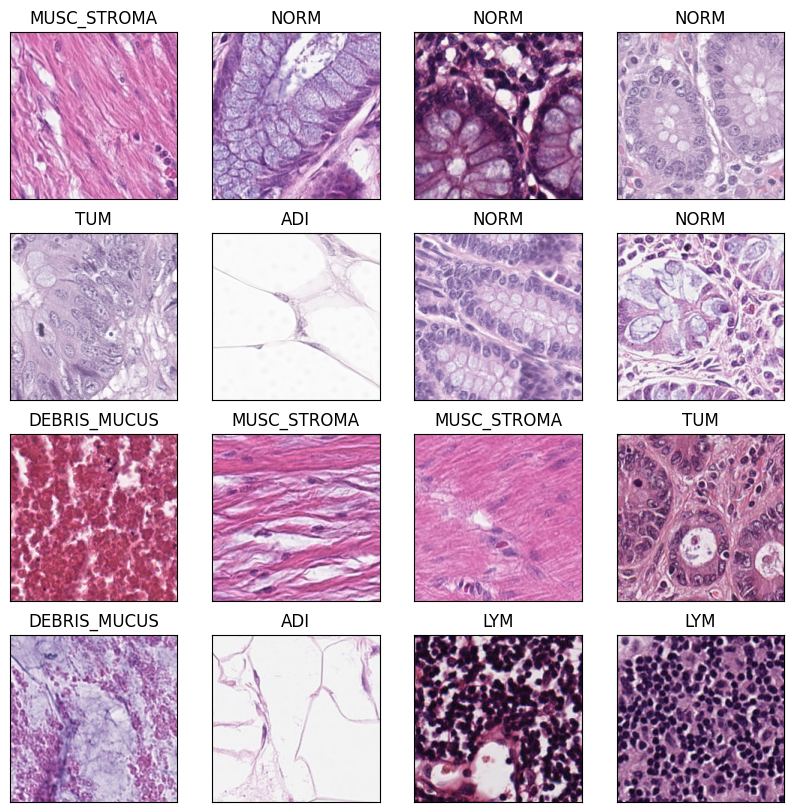

2

In [ ]:
# VGG16
def func_transform():
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ])
    return transform

transformed = func_transform()

full_dataset = datasets.ImageFolder(root=encoded_dir, transform=transformed)

total_size = len(full_dataset)

train_size = int(0.8 * total_size)
test_size = total_size - train_size
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

plot_loader_ = DataLoader(train_dataset, batch_size=16, shuffle=True)

plt.figure(figsize=(10, 10))
for i in range(16):
    ax = plt.subplot(4, 4, i + 1)
    ax.grid(False)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    batch = next(iter(plot_loader_))
    label = int(batch[1].numpy()[0])
    image = np.transpose(batch[0][0].numpy(), (1, 2, 0))
    plt.imshow(image)
    plt.title(full_dataset.classes[label])
plt.show()

batch[1].numpy()[0]


In [ ]:
optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model_VGG16.parameters()), lr=0.00033)
model = model_VGG16
model.to(device)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [ ]:
train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist = train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True)

Epoch 1/30, loss 0.63808, test_loss 0.47747, accuracy 0.80551, test_accuracy 0.84801
Epoch 2/30, loss 0.64680, test_loss 0.95635, accuracy 0.86808, test_accuracy 0.74768
Epoch 3/30, loss 1.64377, test_loss 1.42779, accuracy 0.27255, test_accuracy 0.30659
Epoch 4/30, loss 1.21118, test_loss 1.09106, accuracy 0.45109, test_accuracy 0.53155
Epoch 5/30, loss 0.94593, test_loss 0.74789, accuracy 0.62894, test_accuracy 0.74679
Epoch 6/30, loss 0.73587, test_loss 0.70019, accuracy 0.73706, test_accuracy 0.75030
Epoch 7/30, loss 0.62498, test_loss 0.58268, accuracy 0.78634, test_accuracy 0.81586
Epoch 8/30, loss 0.44659, test_loss 0.59851, accuracy 0.85477, test_accuracy 0.79441
Epoch 9/30, loss 0.43924, test_loss 0.43305, accuracy 0.85664, test_accuracy 0.85452
Epoch 10/30, loss 0.34770, test_loss 0.36351, accuracy 0.89072, test_accuracy 0.88165
Epoch 11/30, loss 0.27950, test_loss 0.30832, accuracy 0.91125, test_accuracy 0.90625
Epoch 12/30, loss 0.25921, test_loss 0.29014, accuracy 0.91509,

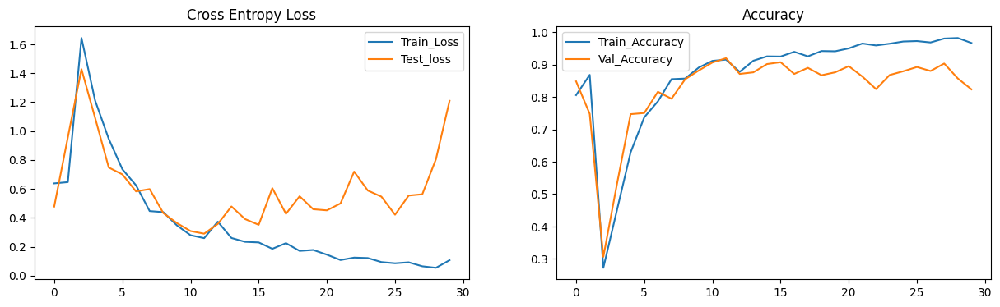

Overall accuracy on test set: 82.2 %
Accuracy of ADI: 100.0 %
Accuracy of DEBRIS_MUCUS: 85.6 %
Accuracy of LYM: 87.2 %
Accuracy of MUSC_STROMA: 62.6 %
Accuracy of NORM: 93.6 %
Accuracy of TUM: 63.6 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     0.7826    1.0000    0.8780       198
         DEB     0.6789    0.8564    0.7574       195
         LYM     0.9779    0.8719    0.9219       203
         MUS     0.9538    0.6263    0.7561       198
        NORM     0.7510    0.9360    0.8333       203
         TUM     0.9545    0.6364    0.7636       198

    accuracy                         0.8218      1195
   macro avg     0.8498    0.8212    0.8184      1195
weighted avg     0.8503    0.8218    0.8190      1195



In [ ]:
plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, '/content/drive/MyDrive/vgg_raw.png')

model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')


all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)


Micro-average Precision for class ADI: 0.9540
Micro-average Recall for class ADI: 0.9540
Micro-average F1-Score for class ADI: 0.9540
Micro-average Precision for class DEB: 0.9105
Micro-average Recall for class DEB: 0.9105
Micro-average F1-Score for class DEB: 0.9105
Micro-average Precision for class LYM: 0.9749
Micro-average Recall for class LYM: 0.9749
Micro-average F1-Score for class LYM: 0.9749
Micro-average Precision for class MUS: 0.9331
Micro-average Recall for class MUS: 0.9331
Micro-average F1-Score for class MUS: 0.9331
Micro-average Precision for class NORM: 0.9364
Micro-average Recall for class NORM: 0.9364
Micro-average F1-Score for class NORM: 0.9364
Micro-average Precision for class TUM: 0.9347
Micro-average Recall for class TUM: 0.9347
Micro-average F1-Score for class TUM: 0.9347


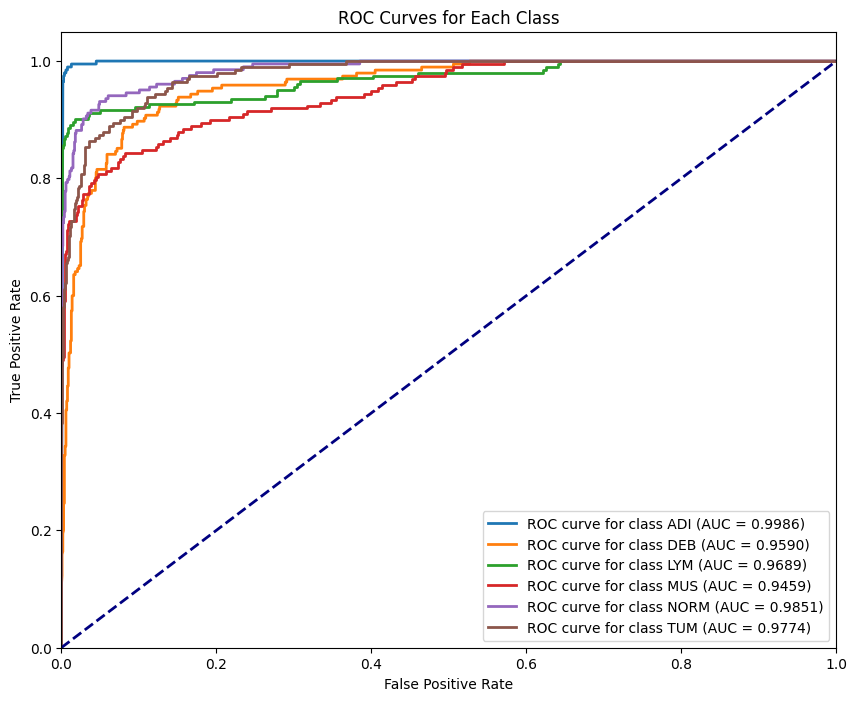

In [ ]:
#precision, recall, f1-score, AUC and ROC base on micro-average
class_names = ['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM']

# Initialize lists to store all predicted probabilities and labels
all_predictions = []
all_labels = []
all_probs = []

# Collect the predicted probabilities and true labels
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Get model outputs (logits)
        outputs = model(inputs)
        # Apply softmax to get probabilities
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        # Append predictions, probabilities, and labels
        all_predictions.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert to numpy arrays
all_predictions = np.array(all_predictions)
all_probs = np.array(all_probs)
all_labels = np.array(all_labels)

#Calculate precision, recall, and f1-score using micro-average for each class
for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)
    binary_preds = np.where(all_predictions == class_idx, 1, 0)

    # Calculate micro-average precision, recall, and f1-score for each class
    precision, recall, f1_score, _ = precision_recall_fscore_support(binary_labels, binary_preds, average='micro')

    # Print the results for each class
    print(f"Micro-average Precision for class {class_name}: {precision:.4f}")
    print(f"Micro-average Recall for class {class_name}: {recall:.4f}")
    print(f"Micro-average F1-Score for class {class_name}: {f1_score:.4f}")

#Calculate ROC and AUC for each class, and plot all ROC curves
plt.figure(figsize=(10, 8))

for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)

    # Calculate ROC curve and AUC for the current class
    fpr, tpr, _ = roc_curve(binary_labels, all_probs[:, class_idx])
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve for the current class
    plt.plot(fpr, tpr, lw=2, label=f'ROC curve for class {class_name} (AUC = {roc_auc:.4f})')

# Plot the diagonal line (chance level)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Configure plot
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Each Class')
plt.legend(loc="lower right")
plt.show()

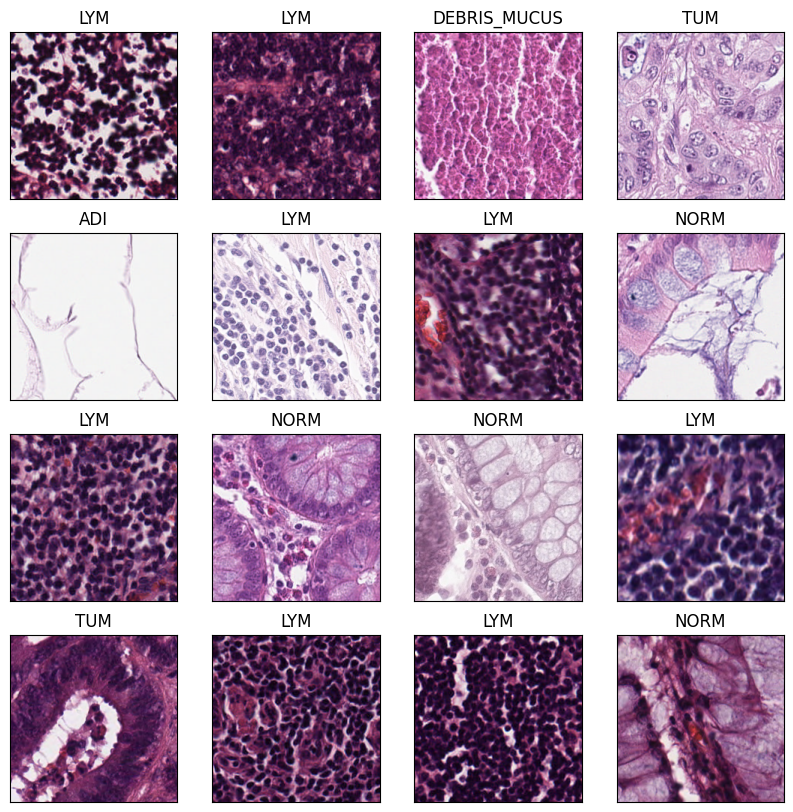

4

In [ ]:
#resnet
def func_transform():
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ])

    return transform

transformed = func_transform()

full_dataset = datasets.ImageFolder(root='/content/demo_raw_datasets', transform= transformed)

total_size = len(full_dataset)

train_size = int(0.8 * total_size)
test_size = total_size - train_size
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, )
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, )

plot_loader_ = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Visualise some examples
plt.figure(figsize=(10,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    ax.grid(False)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    batch = next(iter(plot_loader_))
    label = int(batch[1].numpy()[0])
    image = np.transpose(batch[0][0].numpy(), (1, 2, 0))
    #image = image * std +mean
    plt.imshow(image)
    plt.title(full_dataset.classes[label])
plt.show()

batch[1].numpy()[0]

In [ ]:
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model_resnet.parameters()), lr=0.001)
model = model_resnet
model.to(device)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist = train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True)

Epoch 1/30, loss 0.30213, test_loss 0.17500, accuracy 0.92655, test_accuracy 0.94326
Epoch 2/30, loss 0.19427, test_loss 0.37215, accuracy 0.95248, test_accuracy 0.93750
Epoch 3/30, loss 0.18659, test_loss 0.16055, accuracy 0.95229, test_accuracy 0.95148
Epoch 4/30, loss 0.17884, test_loss 0.26450, accuracy 0.95914, test_accuracy 0.93092
Epoch 5/30, loss 0.14365, test_loss 0.27701, accuracy 0.96813, test_accuracy 0.92599
Epoch 6/30, loss 0.11669, test_loss 0.18959, accuracy 0.96956, test_accuracy 0.94408
Epoch 7/30, loss 0.07806, test_loss 0.23499, accuracy 0.97176, test_accuracy 0.95066
Epoch 8/30, loss 0.06209, test_loss 0.21164, accuracy 0.98396, test_accuracy 0.94655
Epoch 9/30, loss 0.07297, test_loss 0.28663, accuracy 0.97988, test_accuracy 0.91447
Epoch 10/30, loss 0.07869, test_loss 0.17621, accuracy 0.97488, test_accuracy 0.95066
Epoch 11/30, loss 0.09608, test_loss 1.34628, accuracy 0.97417, test_accuracy 0.91126
Epoch 12/30, loss 0.05563, test_loss 0.27348, accuracy 0.98509,

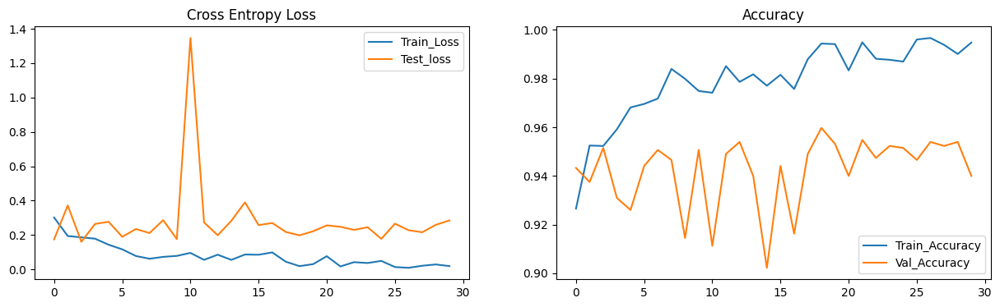

Overall accuracy on test set: 93.9 %
Accuracy of ADI: 99.5 %
Accuracy of DEBRIS_MUCUS: 93.1 %
Accuracy of LYM: 94.9 %
Accuracy of MUSC_STROMA: 95.5 %
Accuracy of NORM: 97.0 %
Accuracy of TUM: 83.9 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     0.9900    0.9950    0.9925       200
         DEB     0.9162    0.9309    0.9235       188
         LYM     0.9296    0.9487    0.9391       195
         MUS     0.9461    0.9554    0.9507       202
        NORM     0.8853    0.9698    0.9257       199
         TUM     0.9725    0.8389    0.9008       211

    accuracy                         0.9389      1195
   macro avg     0.9400    0.9398    0.9387      1195
weighted avg     0.9406    0.9389    0.9385      1195



In [ ]:
plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, '/content/drive/MyDrive/res_raw.png')

model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')


all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)

Micro-average Precision for class ADI: 0.9975
Micro-average Recall for class ADI: 0.9975
Micro-average F1-Score for class ADI: 0.9975
Micro-average Precision for class DEB: 0.9757
Micro-average Recall for class DEB: 0.9757
Micro-average F1-Score for class DEB: 0.9757
Micro-average Precision for class LYM: 0.9799
Micro-average Recall for class LYM: 0.9799
Micro-average F1-Score for class LYM: 0.9799
Micro-average Precision for class MUS: 0.9833
Micro-average Recall for class MUS: 0.9833
Micro-average F1-Score for class MUS: 0.9833
Micro-average Precision for class NORM: 0.9741
Micro-average Recall for class NORM: 0.9741
Micro-average F1-Score for class NORM: 0.9741
Micro-average Precision for class TUM: 0.9674
Micro-average Recall for class TUM: 0.9674
Micro-average F1-Score for class TUM: 0.9674


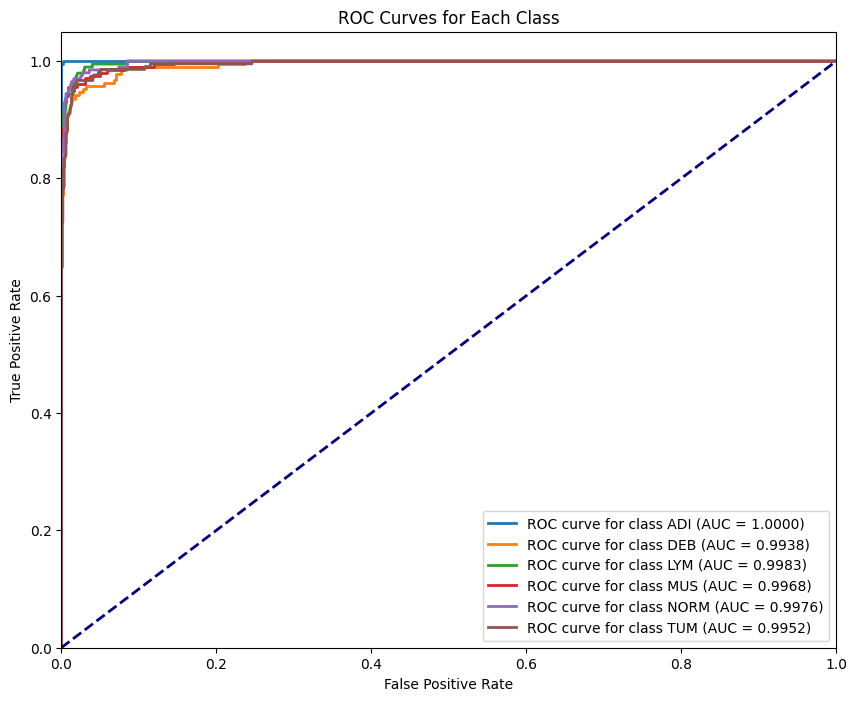

In [ ]:
#precision, recall, f1-score, AUC and ROC base on micro-average
class_names = ['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM']

# Initialize lists to store all predicted probabilities and labels
all_predictions = []
all_labels = []
all_probs = []

# Collect the predicted probabilities and true labels
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Get model outputs (logits)
        outputs = model(inputs)
        # Apply softmax to get probabilities
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        # Append predictions, probabilities, and labels
        all_predictions.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert to numpy arrays
all_predictions = np.array(all_predictions)
all_probs = np.array(all_probs)
all_labels = np.array(all_labels)

#Calculate precision, recall, and f1-score using micro-average for each class
for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)
    binary_preds = np.where(all_predictions == class_idx, 1, 0)

    # Calculate micro-average precision, recall, and f1-score for each class
    precision, recall, f1_score, _ = precision_recall_fscore_support(binary_labels, binary_preds, average='micro')

    # Print the results for each class
    print(f"Micro-average Precision for class {class_name}: {precision:.4f}")
    print(f"Micro-average Recall for class {class_name}: {recall:.4f}")
    print(f"Micro-average F1-Score for class {class_name}: {f1_score:.4f}")

#Calculate ROC and AUC for each class, and plot all ROC curves
plt.figure(figsize=(10, 8))

for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)

    # Calculate ROC curve and AUC for the current class
    fpr, tpr, _ = roc_curve(binary_labels, all_probs[:, class_idx])
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve for the current class
    plt.plot(fpr, tpr, lw=2, label=f'ROC curve for class {class_name} (AUC = {roc_auc:.4f})')

# Plot the diagonal line (chance level)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Configure plot
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Each Class')
plt.legend(loc="lower right")
plt.show()

# Ablation Experiment(Gaussian Filtering+Macenko+Randomly Rotation 90 degrees) VGG16+ResNet50

In [ ]:
#Gaussian Filtering
dataset_path = '/content/demo_raw_datasets'
save_base_path = '/content/demo_gaussian'

for root, dirs, files in os.walk(dataset_path):
    for file in files:

        if file.endswith((".tif", ".png")):
            file_path = os.path.join(root, file)
            image = Image.open(file_path)
            processed_gaussian = apply_gaussian_filter(image)


            relative_path = os.path.relpath(root, dataset_path)
            save_folder = os.path.join(save_base_path, relative_path)

            if not os.path.exists(save_folder):
                os.makedirs(save_folder)


            save_extension = file.split('.')[-1].lower()
            save_path = os.path.join(save_folder, file)


            if save_extension == 'tif':
                processed_gaussian.save(save_path, format='TIFF')
            elif save_extension == 'png':
                processed_gaussian.save(save_path, format='PNG')

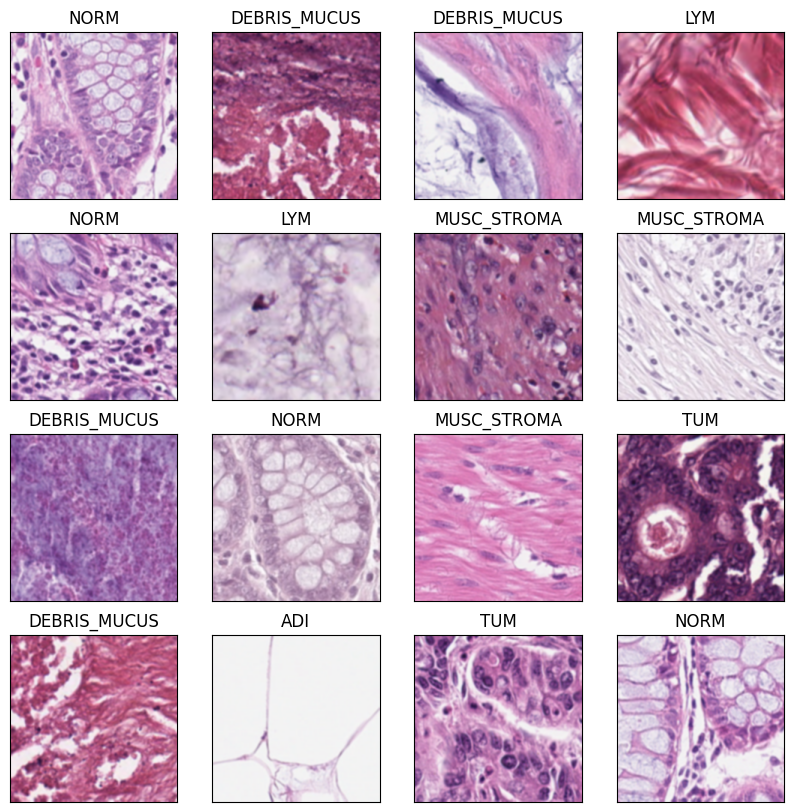

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [ ]:
#VGG16(Gaussian)
def func_transform():
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ])

    return transform

transformed = func_transform()

full_dataset = datasets.ImageFolder(root='/content/demo_gaussian', transform= transformed)

total_size = len(full_dataset)

train_size = int(0.8 * total_size)
test_size = total_size - train_size
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, )
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, )

plot_loader_ = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Visualise some examples
plt.figure(figsize=(10,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    ax.grid(False)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    batch = next(iter(plot_loader_))
    label = int(batch[1].numpy()[0])
    image = np.transpose(batch[0][0].numpy(), (1, 2, 0))
    #image = image * std +mean
    plt.imshow(image)
    plt.title(full_dataset.classes[label])
plt.show()

batch[1].numpy()[0]

optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model_VGG16.parameters()), lr=0.00033)
model = model_VGG16
model.to(device)

In [ ]:
train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist = train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True)

Epoch 1/30, loss 1.23226, test_loss 0.97882, accuracy 0.46565, test_accuracy 0.56953
Epoch 2/30, loss 0.88238, test_loss 0.75557, accuracy 0.63421, test_accuracy 0.66724
Epoch 3/30, loss 0.57710, test_loss 0.53916, accuracy 0.78414, test_accuracy 0.83074
Epoch 4/30, loss 0.47498, test_loss 0.44167, accuracy 0.83697, test_accuracy 0.86274
Epoch 5/30, loss 0.35265, test_loss 0.32894, accuracy 0.88759, test_accuracy 0.90797
Epoch 6/30, loss 0.28001, test_loss 0.31047, accuracy 0.91551, test_accuracy 0.91948
Epoch 7/30, loss 0.33281, test_loss 0.37915, accuracy 0.89831, test_accuracy 0.89975
Epoch 8/30, loss 0.27497, test_loss 0.36338, accuracy 0.90988, test_accuracy 0.91208
Epoch 9/30, loss 0.19811, test_loss 0.45756, accuracy 0.93646, test_accuracy 0.87844
Epoch 10/30, loss 0.22179, test_loss 0.39352, accuracy 0.93363, test_accuracy 0.88248
Epoch 11/30, loss 0.21643, test_loss 0.31703, accuracy 0.93197, test_accuracy 0.90468
Epoch 12/30, loss 0.16346, test_loss 0.30080, accuracy 0.94875,

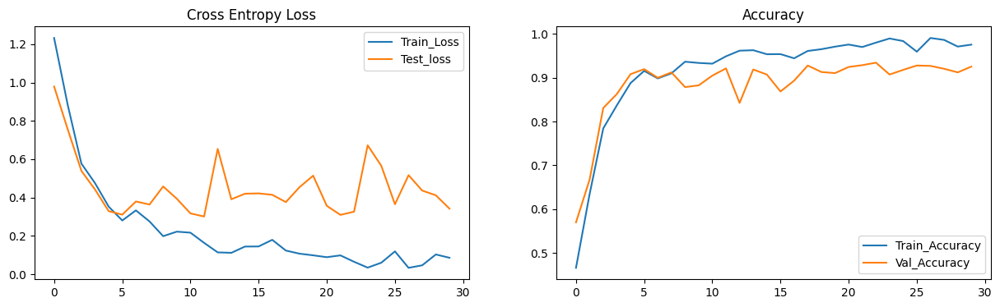

In [ ]:
plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, '/content/drive/MyDrive/Gaussian.png')

In [ ]:
model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')

all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)

Overall accuracy on test set: 92.6 %
Accuracy of ADI: 99.5 %
Accuracy of DEBRIS_MUCUS: 86.8 %
Accuracy of LYM: 93.6 %
Accuracy of MUSC_STROMA: 91.8 %
Accuracy of NORM: 91.3 %
Accuracy of TUM: 91.8 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     0.9679    0.9953    0.9814       212
         DEB     0.8517    0.8683    0.8599       205
         LYM     0.9406    0.9360    0.9383       203
         MUS     0.9455    0.9183    0.9317       208
        NORM     0.9521    0.9133    0.9323       196
         TUM     0.8920    0.9181    0.9049       171

    accuracy                         0.9255      1195
   macro avg     0.9250    0.9249    0.9247      1195
weighted avg     0.9260    0.9255    0.9256      1195



Micro-average Precision for class ADI: 0.9933
Micro-average Recall for class ADI: 0.9933
Micro-average F1-Score for class ADI: 0.9933
Micro-average Precision for class DEB: 0.9515
Micro-average Recall for class DEB: 0.9515
Micro-average F1-Score for class DEB: 0.9515
Micro-average Precision for class LYM: 0.9791
Micro-average Recall for class LYM: 0.9791
Micro-average F1-Score for class LYM: 0.9791
Micro-average Precision for class MUS: 0.9766
Micro-average Recall for class MUS: 0.9766
Micro-average F1-Score for class MUS: 0.9766
Micro-average Precision for class NORM: 0.9782
Micro-average Recall for class NORM: 0.9782
Micro-average F1-Score for class NORM: 0.9782
Micro-average Precision for class TUM: 0.9724
Micro-average Recall for class TUM: 0.9724
Micro-average F1-Score for class TUM: 0.9724


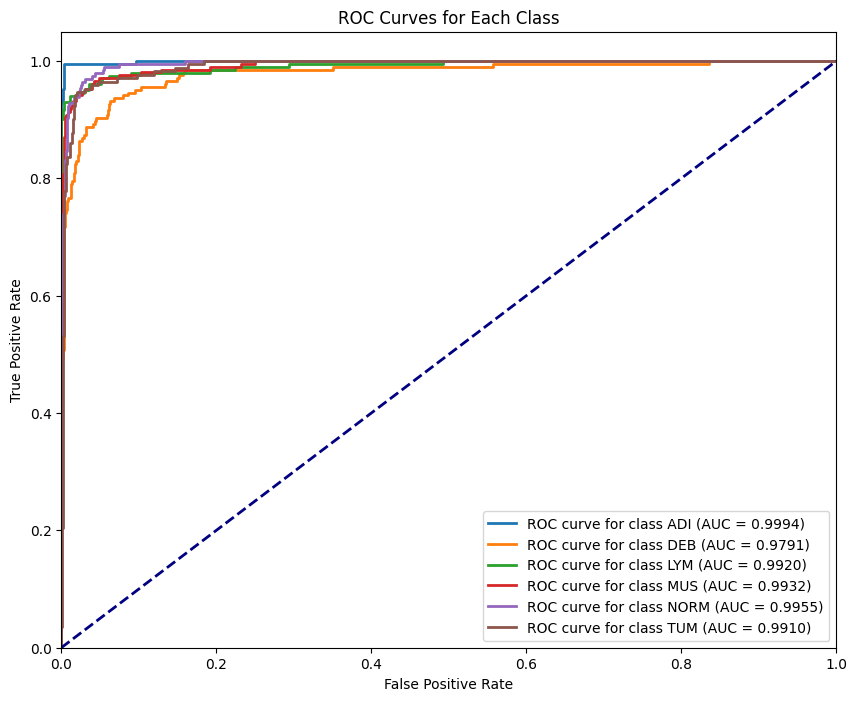

In [ ]:
#precision, recall, f1-score, AUC and ROC base on micro-average
class_names = ['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM']

# Initialize lists to store all predicted probabilities and labels
all_predictions = []
all_labels = []
all_probs = []

# Collect the predicted probabilities and true labels
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Get model outputs (logits)
        outputs = model(inputs)
        # Apply softmax to get probabilities
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        # Append predictions, probabilities, and labels
        all_predictions.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert to numpy arrays
all_predictions = np.array(all_predictions)
all_probs = np.array(all_probs)
all_labels = np.array(all_labels)

#Calculate precision, recall, and f1-score using micro-average for each class
for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)
    binary_preds = np.where(all_predictions == class_idx, 1, 0)

    # Calculate micro-average precision, recall, and f1-score for each class
    precision, recall, f1_score, _ = precision_recall_fscore_support(binary_labels, binary_preds, average='micro')

    # Print the results for each class
    print(f"Micro-average Precision for class {class_name}: {precision:.4f}")
    print(f"Micro-average Recall for class {class_name}: {recall:.4f}")
    print(f"Micro-average F1-Score for class {class_name}: {f1_score:.4f}")

#Calculate ROC and AUC for each class, and plot all ROC curves
plt.figure(figsize=(10, 8))

for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)

    # Calculate ROC curve and AUC for the current class
    fpr, tpr, _ = roc_curve(binary_labels, all_probs[:, class_idx])
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve for the current class
    plt.plot(fpr, tpr, lw=2, label=f'ROC curve for class {class_name} (AUC = {roc_auc:.4f})')

# Plot the diagonal line (chance level)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Configure plot
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Each Class')
plt.legend(loc="lower right")
plt.show()

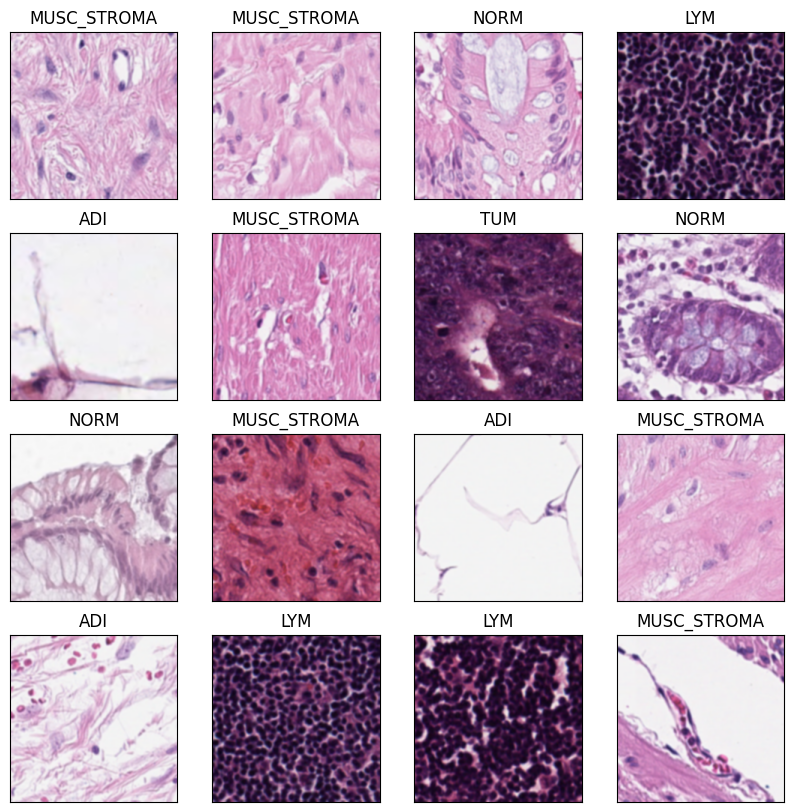

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
#resnet50(Gaussian)
def func_transform():
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ])

    return transform

transformed = func_transform()

full_dataset = datasets.ImageFolder(root='/content/demo_gaussian', transform= transformed)

total_size = len(full_dataset)

train_size = int(0.8 * total_size)
test_size = total_size - train_size
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, )
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, )

plot_loader_ = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Visualise some examples
plt.figure(figsize=(10,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    ax.grid(False)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    batch = next(iter(plot_loader_))
    label = int(batch[1].numpy()[0])
    image = np.transpose(batch[0][0].numpy(), (1, 2, 0))
    #image = image * std +mean
    plt.imshow(image)
    plt.title(full_dataset.classes[label])
plt.show()

batch[1].numpy()[0]
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model_resnet.parameters()), lr=0.001)
model = model_resnet
model.to(device)


In [ ]:
train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist = train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True)

Epoch 1/30, loss 0.44141, test_loss 0.40386, accuracy 0.86488, test_accuracy 0.86857
Epoch 2/30, loss 0.26212, test_loss 0.21887, accuracy 0.92197, test_accuracy 0.93339
Epoch 3/30, loss 0.17838, test_loss 0.22426, accuracy 0.94405, test_accuracy 0.93750
Epoch 4/30, loss 0.10967, test_loss 0.21292, accuracy 0.96604, test_accuracy 0.93257
Epoch 5/30, loss 0.10634, test_loss 0.20537, accuracy 0.96572, test_accuracy 0.94243
Epoch 6/30, loss 0.05835, test_loss 0.26968, accuracy 0.98271, test_accuracy 0.92434
Epoch 7/30, loss 0.06370, test_loss 0.29850, accuracy 0.97822, test_accuracy 0.92599
Epoch 8/30, loss 0.04498, test_loss 0.23989, accuracy 0.98625, test_accuracy 0.93586
Epoch 9/30, loss 0.04144, test_loss 0.28265, accuracy 0.98667, test_accuracy 0.93182
Epoch 10/30, loss 0.02936, test_loss 0.28282, accuracy 0.99083, test_accuracy 0.92771
Epoch 11/30, loss 0.03511, test_loss 0.23920, accuracy 0.98833, test_accuracy 0.94326
Epoch 12/30, loss 0.05440, test_loss 0.22161, accuracy 0.98113,

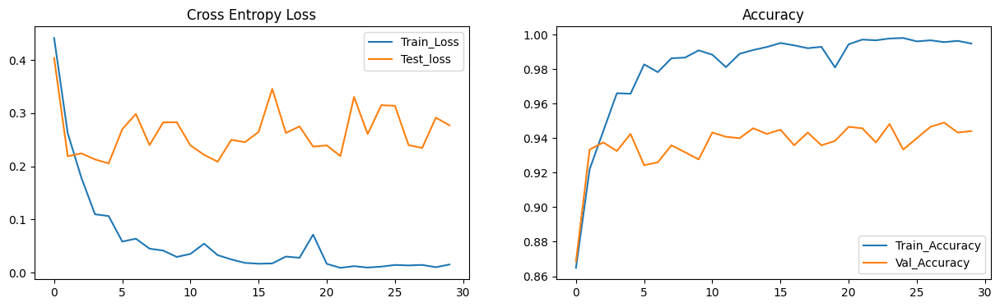

In [ ]:
plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, '/content/drive/MyDrive/res_gaussian.png')


In [ ]:
model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')


all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)


Overall accuracy on test set: 94.3 %
Accuracy of ADI: 98.9 %
Accuracy of DEBRIS_MUCUS: 88.2 %
Accuracy of LYM: 91.1 %
Accuracy of MUSC_STROMA: 97.2 %
Accuracy of NORM: 92.5 %
Accuracy of TUM: 98.6 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     0.9946    0.9892    0.9919       185
         DEB     0.9086    0.8818    0.8950       203
         LYM     0.9749    0.9108    0.9417       213
         MUS     0.9211    0.9722    0.9459       180
        NORM     0.9735    0.9246    0.9485       199
         TUM     0.8983    0.9860    0.9401       215

    accuracy                         0.9431      1195
   macro avg     0.9452    0.9441    0.9439      1195
weighted avg     0.9446    0.9431    0.9430      1195



Micro-average Precision for class ADI: 0.9975
Micro-average Recall for class ADI: 0.9975
Micro-average F1-Score for class ADI: 0.9975
Micro-average Precision for class DEB: 0.9649
Micro-average Recall for class DEB: 0.9649
Micro-average F1-Score for class DEB: 0.9649
Micro-average Precision for class LYM: 0.9799
Micro-average Recall for class LYM: 0.9799
Micro-average F1-Score for class LYM: 0.9799
Micro-average Precision for class MUS: 0.9833
Micro-average Recall for class MUS: 0.9833
Micro-average F1-Score for class MUS: 0.9833
Micro-average Precision for class NORM: 0.9833
Micro-average Recall for class NORM: 0.9833
Micro-average F1-Score for class NORM: 0.9833
Micro-average Precision for class TUM: 0.9774
Micro-average Recall for class TUM: 0.9774
Micro-average F1-Score for class TUM: 0.9774


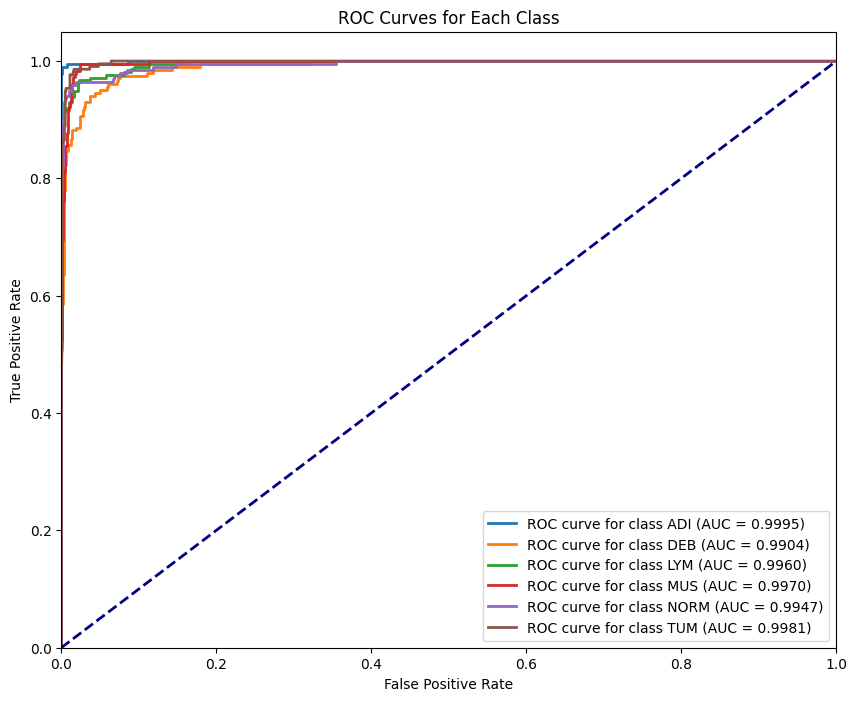

In [ ]:
#precision, recall, f1-score, AUC and ROC base on micro-average
class_names = ['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM']

# Initialize lists to store all predicted probabilities and labels
all_predictions = []
all_labels = []
all_probs = []

# Collect the predicted probabilities and true labels
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Get model outputs (logits)
        outputs = model(inputs)
        # Apply softmax to get probabilities
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        # Append predictions, probabilities, and labels
        all_predictions.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert to numpy arrays
all_predictions = np.array(all_predictions)
all_probs = np.array(all_probs)
all_labels = np.array(all_labels)

#Calculate precision, recall, and f1-score using micro-average for each class
for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)
    binary_preds = np.where(all_predictions == class_idx, 1, 0)

    # Calculate micro-average precision, recall, and f1-score for each class
    precision, recall, f1_score, _ = precision_recall_fscore_support(binary_labels, binary_preds, average='micro')

    # Print the results for each class
    print(f"Micro-average Precision for class {class_name}: {precision:.4f}")
    print(f"Micro-average Recall for class {class_name}: {recall:.4f}")
    print(f"Micro-average F1-Score for class {class_name}: {f1_score:.4f}")

#Calculate ROC and AUC for each class, and plot all ROC curves
plt.figure(figsize=(10, 8))

for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)

    # Calculate ROC curve and AUC for the current class
    fpr, tpr, _ = roc_curve(binary_labels, all_probs[:, class_idx])
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve for the current class
    plt.plot(fpr, tpr, lw=2, label=f'ROC curve for class {class_name} (AUC = {roc_auc:.4f})')

# Plot the diagonal line (chance level)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Configure plot
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Each Class')
plt.legend(loc="lower right")
plt.show()

In [ ]:
#Macenko

def batch_stain_normalization(input_folder, output_folder):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    normalizer = Macenko_Normalizer()

    reference_image_filename = "/content/reference_image_1.png"
    reference_image = np.array(Image.open(reference_image_filename))

    normalizer.fit(reference_image)

    skipped_images_count = 0

    for root, dirs, files in os.walk(input_folder):
        relative_path = os.path.relpath(root, input_folder)
        output_subfolder = os.path.join(output_folder, relative_path)

        if not os.path.exists(output_subfolder):
            os.makedirs(output_subfolder)

        for filename in files:
            if filename.lower().endswith((".jpg", ".jpeg", ".png", ".tif", ".tiff")):
                input_image_path = os.path.join(root, filename)
                output_image_path = os.path.join(output_subfolder, filename)

                image = np.array(Image.open(input_image_path))

                try:
                    normalized_image = normalizer.transform(image)

                    Image.fromarray(normalized_image).save(output_image_path)
                    print(f"Normalized image saved to {output_image_path}")

                except (np.linalg.LinAlgError, ValueError) as e:
                    print(f"Skipping image {filename} due to error: {e}")
                    shutil.copy(input_image_path, output_image_path)
                    print(f"Original image copied to {output_image_path}")
                    skipped_images_count += 1

    print(f"\nBatch stain normalization completed. {skipped_images_count} images were skipped and copied without processing.")

input_images_folder = "/content/demo_raw_datasets"
output_folder = "/content/demo_macenko"

batch_stain_normalization(input_images_folder, output_folder)


流式输出内容被截断，只能显示最后 5000 行内容。
Normalized image saved to /content/demo_macenko/MUSC_STROMA/MUS-LPVCNCLY.tif
Normalized image saved to /content/demo_macenko/MUSC_STROMA/MUS-TNNIHNSI.tif
Normalized image saved to /content/demo_macenko/MUSC_STROMA/MUS-YCVYMDNE.tif
Normalized image saved to /content/demo_macenko/MUSC_STROMA/STR-VQHESHAR.tif
Normalized image saved to /content/demo_macenko/MUSC_STROMA/STR-ANFHCEPA.tif
Normalized image saved to /content/demo_macenko/MUSC_STROMA/MUS-LQRYWADN.tif
Normalized image saved to /content/demo_macenko/MUSC_STROMA/STR-NFMQECAH.tif
Normalized image saved to /content/demo_macenko/MUSC_STROMA/CRC_MUSC_STROMA_2081.png
Normalized image saved to /content/demo_macenko/MUSC_STROMA/STR-MDHTCRYQ.tif
Normalized image saved to /content/demo_macenko/MUSC_STROMA/MUS-DLWASQNN.tif
Normalized image saved to /content/demo_macenko/MUSC_STROMA/MUS-LREKWNFR.tif
Normalized image saved to /content/demo_macenko/MUSC_STROMA/STR-NLEDPKIH.tif
Normalized image saved to /content/demo_m

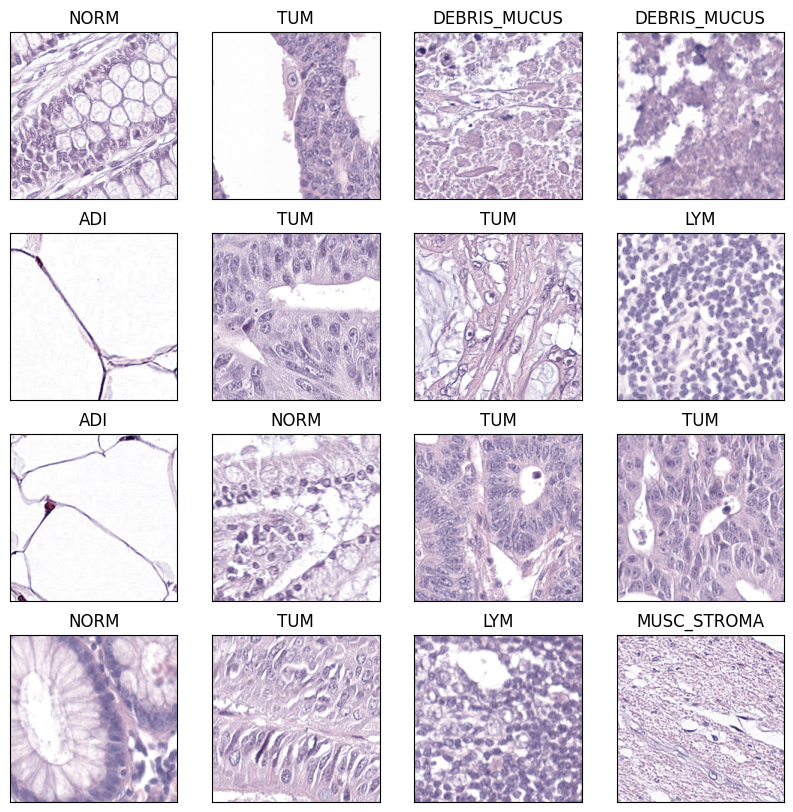

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [ ]:
#VGG16(Macenko)
def func_transform():
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ])

    return transform

transformed = func_transform()

full_dataset = datasets.ImageFolder(root='/content/demo_macenko', transform= transformed)

total_size = len(full_dataset)

train_size = int(0.8 * total_size)
test_size = total_size - train_size
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, )
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, )

plot_loader_ = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Visualise some examples
plt.figure(figsize=(10,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    ax.grid(False)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    batch = next(iter(plot_loader_))
    label = int(batch[1].numpy()[0])
    image = np.transpose(batch[0][0].numpy(), (1, 2, 0))
    #image = image * std +mean
    plt.imshow(image)
    plt.title(full_dataset.classes[label])
plt.show()

batch[1].numpy()[0]

optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model_VGG16.parameters()), lr=0.00033)
model = model_VGG16
model.to(device)

In [ ]:
train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist = train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True)

Epoch 1/30, loss 0.28595, test_loss 0.20029, accuracy 0.92500, test_accuracy 0.94079
Epoch 2/30, loss 0.14939, test_loss 0.21776, accuracy 0.95708, test_accuracy 0.93257
Epoch 3/30, loss 0.10076, test_loss 0.12881, accuracy 0.96676, test_accuracy 0.96135
Epoch 4/30, loss 0.10511, test_loss 0.18029, accuracy 0.97021, test_accuracy 0.95073
Epoch 5/30, loss 0.08591, test_loss 0.45053, accuracy 0.97644, test_accuracy 0.91036
Epoch 6/30, loss 0.10473, test_loss 0.23328, accuracy 0.97000, test_accuracy 0.94744
Epoch 7/30, loss 0.12082, test_loss 0.24733, accuracy 0.96208, test_accuracy 0.95230
Epoch 8/30, loss 0.06352, test_loss 0.22481, accuracy 0.98146, test_accuracy 0.95395
Epoch 9/30, loss 0.07826, test_loss 0.21163, accuracy 0.97875, test_accuracy 0.93922
Epoch 10/30, loss 0.10722, test_loss 0.32179, accuracy 0.97125, test_accuracy 0.94161
Epoch 11/30, loss 0.07834, test_loss 0.27269, accuracy 0.97521, test_accuracy 0.94984
Epoch 12/30, loss 0.01987, test_loss 0.42740, accuracy 0.99271,

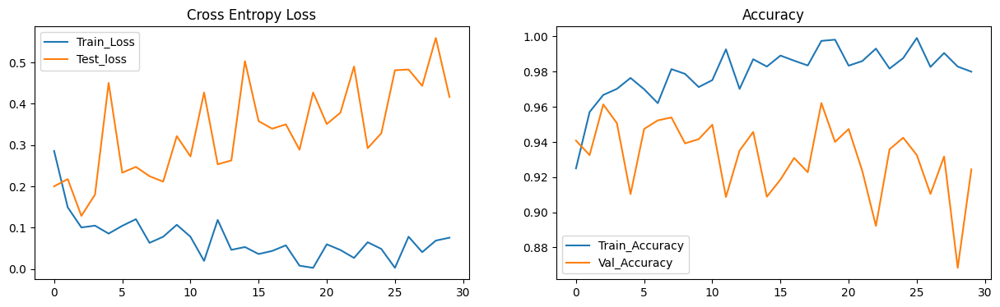

In [ ]:
plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, '/content/drive/MyDrive/vgg_macenko.png')

In [ ]:
model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')

all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)

Overall accuracy on test set: 92.5 %
Accuracy of ADI: 96.3 %
Accuracy of DEBRIS_MUCUS: 80.7 %
Accuracy of LYM: 90.6 %
Accuracy of MUSC_STROMA: 94.7 %
Accuracy of NORM: 96.3 %
Accuracy of TUM: 95.3 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     0.9953    0.9633    0.9790       218
         DEB     0.8807    0.8073    0.8424       192
         LYM     0.9721    0.9062    0.9380       192
         MUS     0.9378    0.9469    0.9423       207
        NORM     0.8387    0.9630    0.8966       216
         TUM     0.9419    0.9529    0.9474       170

    accuracy                         0.9247      1195
   macro avg     0.9277    0.9233    0.9243      1195
weighted avg     0.9273    0.9247    0.9247      1195



Micro-average Precision for class ADI: 0.9925
Micro-average Recall for class ADI: 0.9925
Micro-average F1-Score for class ADI: 0.9925
Micro-average Precision for class DEB: 0.9515
Micro-average Recall for class DEB: 0.9515
Micro-average F1-Score for class DEB: 0.9515
Micro-average Precision for class LYM: 0.9808
Micro-average Recall for class LYM: 0.9808
Micro-average F1-Score for class LYM: 0.9808
Micro-average Precision for class MUS: 0.9799
Micro-average Recall for class MUS: 0.9799
Micro-average F1-Score for class MUS: 0.9799
Micro-average Precision for class NORM: 0.9598
Micro-average Recall for class NORM: 0.9598
Micro-average F1-Score for class NORM: 0.9598
Micro-average Precision for class TUM: 0.9849
Micro-average Recall for class TUM: 0.9849
Micro-average F1-Score for class TUM: 0.9849


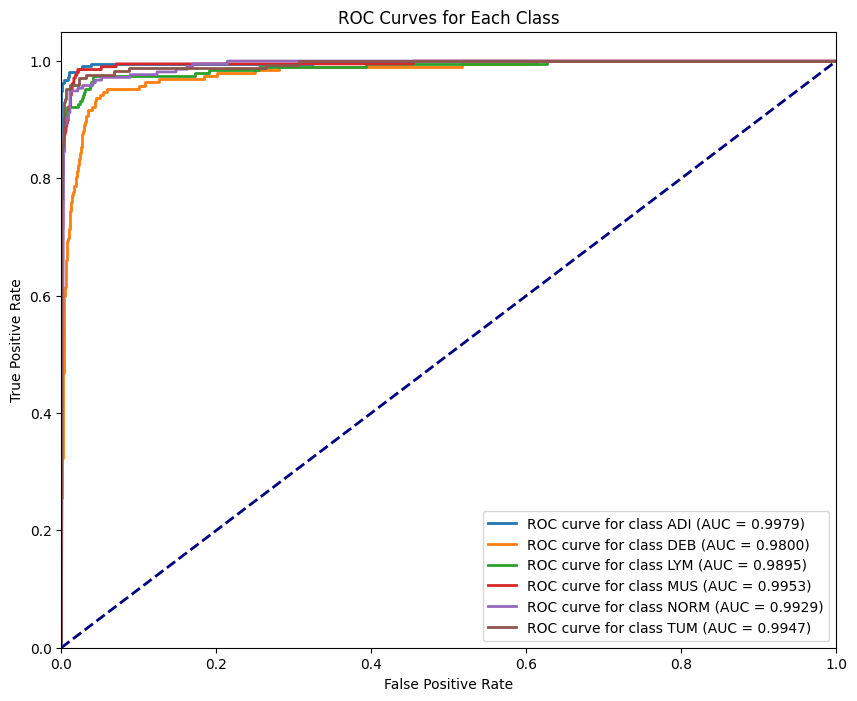

In [ ]:
#precision, recall, f1-score, AUC and ROC base on micro-average
class_names = ['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM']

# Initialize lists to store all predicted probabilities and labels
all_predictions = []
all_labels = []
all_probs = []

# Collect the predicted probabilities and true labels
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Get model outputs (logits)
        outputs = model(inputs)
        # Apply softmax to get probabilities
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        # Append predictions, probabilities, and labels
        all_predictions.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert to numpy arrays
all_predictions = np.array(all_predictions)
all_probs = np.array(all_probs)
all_labels = np.array(all_labels)

#Calculate precision, recall, and f1-score using micro-average for each class
for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)
    binary_preds = np.where(all_predictions == class_idx, 1, 0)

    # Calculate micro-average precision, recall, and f1-score for each class
    precision, recall, f1_score, _ = precision_recall_fscore_support(binary_labels, binary_preds, average='micro')

    # Print the results for each class
    print(f"Micro-average Precision for class {class_name}: {precision:.4f}")
    print(f"Micro-average Recall for class {class_name}: {recall:.4f}")
    print(f"Micro-average F1-Score for class {class_name}: {f1_score:.4f}")

#Calculate ROC and AUC for each class, and plot all ROC curves
plt.figure(figsize=(10, 8))

for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)

    # Calculate ROC curve and AUC for the current class
    fpr, tpr, _ = roc_curve(binary_labels, all_probs[:, class_idx])
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve for the current class
    plt.plot(fpr, tpr, lw=2, label=f'ROC curve for class {class_name} (AUC = {roc_auc:.4f})')

# Plot the diagonal line (chance level)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Configure plot
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Each Class')
plt.legend(loc="lower right")
plt.show()

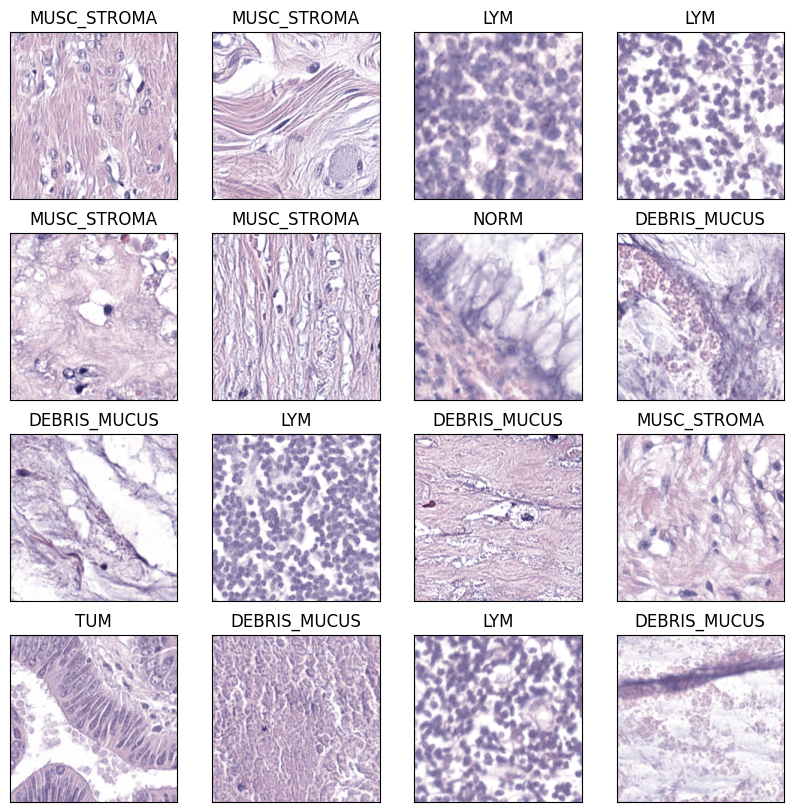

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
#Resnet(Macenko)
def func_transform():
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ])

    return transform

transformed = func_transform()

full_dataset = datasets.ImageFolder(root='/content/demo_macenko', transform= transformed)

total_size = len(full_dataset)

train_size = int(0.8 * total_size)
test_size = total_size - train_size
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, )
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, )

plot_loader_ = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Visualise some examples
plt.figure(figsize=(10,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    ax.grid(False)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    batch = next(iter(plot_loader_))
    label = int(batch[1].numpy()[0])
    image = np.transpose(batch[0][0].numpy(), (1, 2, 0))
    #image = image * std +mean
    plt.imshow(image)
    plt.title(full_dataset.classes[label])
plt.show()

batch[1].numpy()[0]
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model_resnet.parameters()), lr=0.001)
model = model_resnet
model.to(device)

In [ ]:
train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist = train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True)

Epoch 1/30, loss 0.16931, test_loss 0.08349, accuracy 0.94914, test_accuracy 0.97204
Epoch 2/30, loss 0.06625, test_loss 0.07576, accuracy 0.97935, test_accuracy 0.97697
Epoch 3/30, loss 0.03586, test_loss 0.11834, accuracy 0.99039, test_accuracy 0.96225
Epoch 4/30, loss 0.03317, test_loss 0.08393, accuracy 0.98875, test_accuracy 0.97705
Epoch 5/30, loss 0.01638, test_loss 0.08139, accuracy 0.99500, test_accuracy 0.97615
Epoch 6/30, loss 0.01365, test_loss 0.12601, accuracy 0.99583, test_accuracy 0.96546
Epoch 7/30, loss 0.04575, test_loss 0.10221, accuracy 0.98551, test_accuracy 0.97204
Epoch 8/30, loss 0.02848, test_loss 0.07718, accuracy 0.99155, test_accuracy 0.97862
Epoch 9/30, loss 0.00643, test_loss 0.08176, accuracy 0.99792, test_accuracy 0.97376
Epoch 10/30, loss 0.00630, test_loss 0.09393, accuracy 0.99771, test_accuracy 0.97615
Epoch 11/30, loss 0.01504, test_loss 0.13359, accuracy 0.99447, test_accuracy 0.96464
Epoch 12/30, loss 0.01365, test_loss 0.12118, accuracy 0.99542,

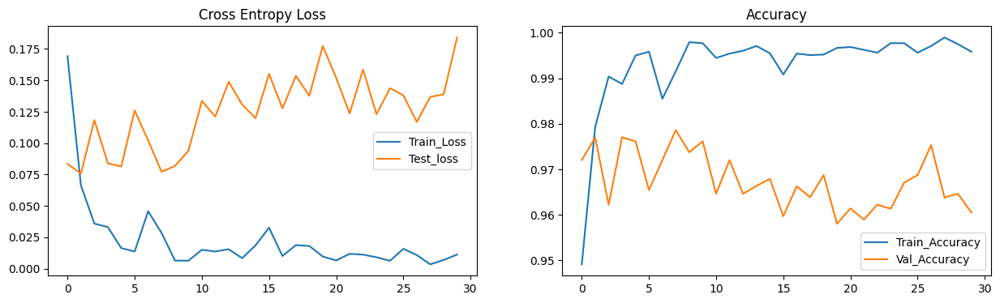

In [ ]:
plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, '/content/drive/MyDrive/res_macenko.png')

In [ ]:
model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')


all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)

Overall accuracy on test set: 96.0 %
Accuracy of ADI: 98.4 %
Accuracy of DEBRIS_MUCUS: 90.9 %
Accuracy of LYM: 96.2 %
Accuracy of MUSC_STROMA: 99.5 %
Accuracy of NORM: 98.2 %
Accuracy of TUM: 92.2 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     0.9844    0.9844    0.9844       192
         DEB     0.9783    0.9091    0.9424       198
         LYM     0.9488    0.9623    0.9555       212
         MUS     0.9190    0.9948    0.9554       194
        NORM     0.9729    0.9817    0.9773       219
         TUM     0.9595    0.9222    0.9405       180

    accuracy                         0.9598      1195
   macro avg     0.9605    0.9591    0.9593      1195
weighted avg     0.9606    0.9598    0.9597      1195



Micro-average Precision for class ADI: 0.9950
Micro-average Recall for class ADI: 0.9950
Micro-average F1-Score for class ADI: 0.9950
Micro-average Precision for class DEB: 0.9816
Micro-average Recall for class DEB: 0.9816
Micro-average F1-Score for class DEB: 0.9816
Micro-average Precision for class LYM: 0.9841
Micro-average Recall for class LYM: 0.9841
Micro-average F1-Score for class LYM: 0.9841
Micro-average Precision for class MUS: 0.9849
Micro-average Recall for class MUS: 0.9849
Micro-average F1-Score for class MUS: 0.9849
Micro-average Precision for class NORM: 0.9916
Micro-average Recall for class NORM: 0.9916
Micro-average F1-Score for class NORM: 0.9916
Micro-average Precision for class TUM: 0.9824
Micro-average Recall for class TUM: 0.9824
Micro-average F1-Score for class TUM: 0.9824


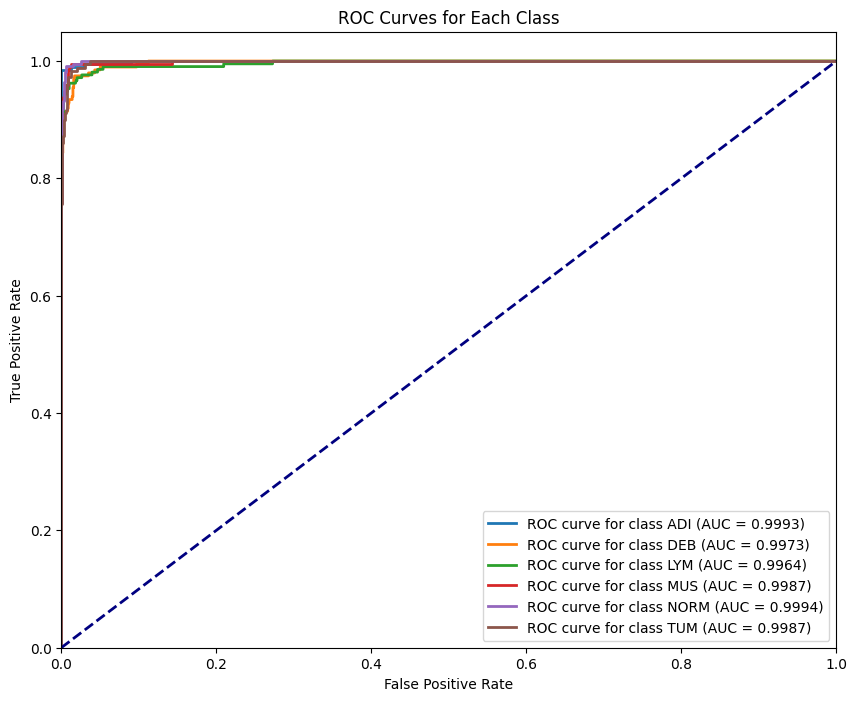

In [ ]:
#precision, recall, f1-score, AUC and ROC base on micro-average
class_names = ['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM']

# Initialize lists to store all predicted probabilities and labels
all_predictions = []
all_labels = []
all_probs = []

# Collect the predicted probabilities and true labels
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Get model outputs (logits)
        outputs = model(inputs)
        # Apply softmax to get probabilities
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        # Append predictions, probabilities, and labels
        all_predictions.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert to numpy arrays
all_predictions = np.array(all_predictions)
all_probs = np.array(all_probs)
all_labels = np.array(all_labels)

#Calculate precision, recall, and f1-score using micro-average for each class
for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)
    binary_preds = np.where(all_predictions == class_idx, 1, 0)

    # Calculate micro-average precision, recall, and f1-score for each class
    precision, recall, f1_score, _ = precision_recall_fscore_support(binary_labels, binary_preds, average='micro')

    # Print the results for each class
    print(f"Micro-average Precision for class {class_name}: {precision:.4f}")
    print(f"Micro-average Recall for class {class_name}: {recall:.4f}")
    print(f"Micro-average F1-Score for class {class_name}: {f1_score:.4f}")

#Calculate ROC and AUC for each class, and plot all ROC curves
plt.figure(figsize=(10, 8))

for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)

    # Calculate ROC curve and AUC for the current class
    fpr, tpr, _ = roc_curve(binary_labels, all_probs[:, class_idx])
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve for the current class
    plt.plot(fpr, tpr, lw=2, label=f'ROC curve for class {class_name} (AUC = {roc_auc:.4f})')

# Plot the diagonal line (chance level)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Configure plot
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Each Class')
plt.legend(loc="lower right")
plt.show()

In [ ]:
dataset_path = '/content/demo_raw_datasets'
rotation_path = '/content/demo_rotation'

all_images = []
for root, dirs, files in os.walk(dataset_path):
    for file in files:
        if file.endswith(('.tif', '.png')):
            all_images.append(os.path.join(root, file))

print(f"Found {len(all_images)} images in the dataset.")

rotation_images = random.sample(all_images, int(len(all_images) * 0.2))
rotation_images_set = set(rotation_images)
print(f"Selected {len(rotation_images)} images for rotation.")

for file_path in all_images:
    image = Image.open(file_path)

    relative_path = os.path.relpath(os.path.dirname(file_path), dataset_path)
    save_folder = os.path.join(rotation_path, relative_path)

    if not os.path.exists(save_folder):
        os.makedirs(save_folder)

    if file_path in rotation_images_set:
        processed_image = rotate_image(image)
        print(f"Rotating and saving image: {file_path}")
    else:
        processed_image = image
        print(f"Saving original image (no rotation): {file_path}")

    save_extension = file_path.split('.')[-1].lower()
    save_path = os.path.join(save_folder, os.path.basename(file_path))

    if save_extension == 'tif':
        processed_image.save(save_path, format='TIFF')
    elif save_extension == 'png':
        processed_image.save(save_path, format='PNG')

    image.close()
    processed_image.close()

print('All images processed and saved.')


流式输出内容被截断，只能显示最后 5000 行内容。
Saving original image (no rotation): /content/demo_raw_datasets/MUSC_STROMA/STR-IMAIFLRT.tif
Rotating and saving image: /content/demo_raw_datasets/MUSC_STROMA/MUS-VFCFFPVA.tif
Saving original image (no rotation): /content/demo_raw_datasets/MUSC_STROMA/MUS-LPVCNCLY.tif
Saving original image (no rotation): /content/demo_raw_datasets/MUSC_STROMA/MUS-TNNIHNSI.tif
Saving original image (no rotation): /content/demo_raw_datasets/MUSC_STROMA/MUS-YCVYMDNE.tif
Saving original image (no rotation): /content/demo_raw_datasets/MUSC_STROMA/STR-VQHESHAR.tif
Rotating and saving image: /content/demo_raw_datasets/MUSC_STROMA/STR-ANFHCEPA.tif
Saving original image (no rotation): /content/demo_raw_datasets/MUSC_STROMA/MUS-LQRYWADN.tif
Saving original image (no rotation): /content/demo_raw_datasets/MUSC_STROMA/STR-NFMQECAH.tif
Rotating and saving image: /content/demo_raw_datasets/MUSC_STROMA/CRC_MUSC_STROMA_2081.png
Saving original image (no rotation): /content/demo_raw_datasets/M

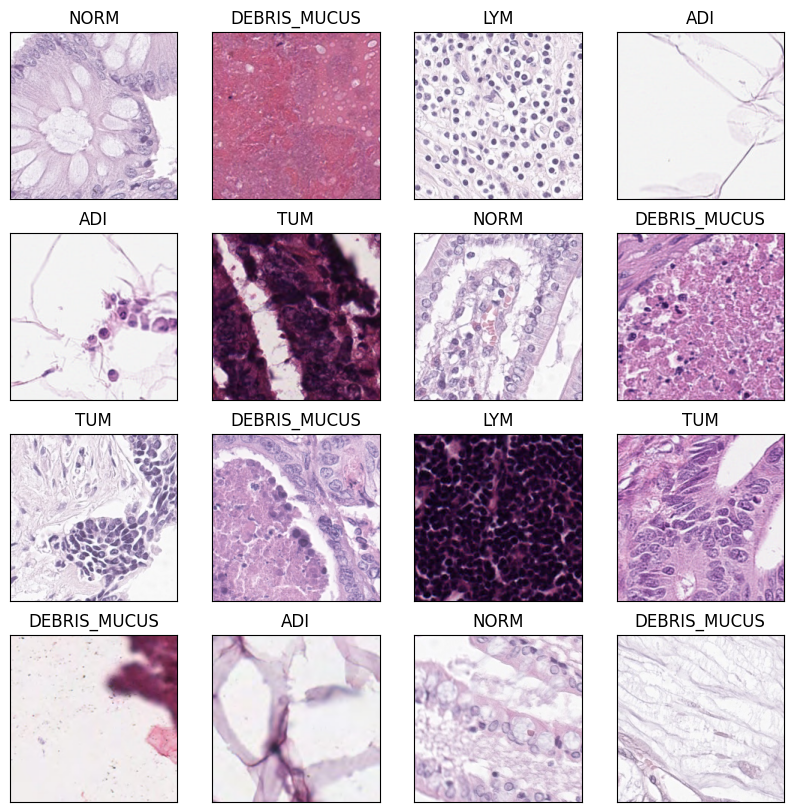

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [ ]:
#VGG(rotation)
def func_transform():
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ])

    return transform

transformed = func_transform()

full_dataset = datasets.ImageFolder(root='/content/demo_rotation', transform= transformed)

total_size = len(full_dataset)

train_size = int(0.8 * total_size)
test_size = total_size - train_size
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, )
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, )

plot_loader_ = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Visualise some examples
plt.figure(figsize=(10,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    ax.grid(False)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    batch = next(iter(plot_loader_))
    label = int(batch[1].numpy()[0])
    image = np.transpose(batch[0][0].numpy(), (1, 2, 0))
    #image = image * std +mean
    plt.imshow(image)
    plt.title(full_dataset.classes[label])
plt.show()

batch[1].numpy()[0]

optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model_VGG16.parameters()), lr=0.00033)
model = model_VGG16
model.to(device)

In [ ]:
train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist = train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True)

Epoch 1/30, loss 1.74850, test_loss 1.33548, accuracy 0.31893, test_accuracy 0.34348
Epoch 2/30, loss 1.07303, test_loss 0.99780, accuracy 0.52245, test_accuracy 0.52988
Epoch 3/30, loss 0.87807, test_loss 0.73410, accuracy 0.64470, test_accuracy 0.70779
Epoch 4/30, loss 0.72836, test_loss 0.53483, accuracy 0.69897, test_accuracy 0.79413
Epoch 5/30, loss 0.61980, test_loss 0.56187, accuracy 0.76514, test_accuracy 0.76535
Epoch 6/30, loss 0.51303, test_loss 0.60204, accuracy 0.81609, test_accuracy 0.80537
Epoch 7/30, loss 0.40065, test_loss 0.61365, accuracy 0.87115, test_accuracy 0.80811
Epoch 8/30, loss 0.41074, test_loss 0.61127, accuracy 0.87210, test_accuracy 0.81113
Epoch 9/30, loss 0.28144, test_loss 0.31163, accuracy 0.91042, test_accuracy 0.90077
Epoch 10/30, loss 0.25980, test_loss 0.36040, accuracy 0.91981, test_accuracy 0.88569
Epoch 11/30, loss 0.24558, test_loss 0.33565, accuracy 0.92146, test_accuracy 0.89912
Epoch 12/30, loss 0.19570, test_loss 0.27867, accuracy 0.93750,

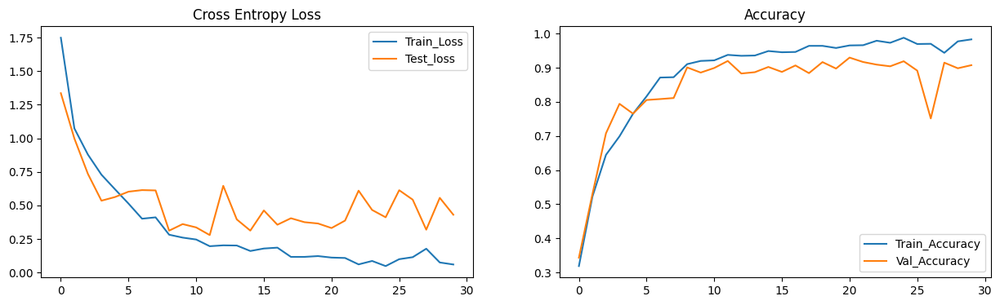

In [ ]:
plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, '/content/drive/MyDrive/vgg_rotation.png')

In [ ]:
model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')

all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)


Overall accuracy on test set: 91.1 %
Accuracy of ADI: 94.6 %
Accuracy of DEBRIS_MUCUS: 88.5 %
Accuracy of LYM: 87.1 %
Accuracy of MUSC_STROMA: 91.2 %
Accuracy of NORM: 95.6 %
Accuracy of TUM: 89.1 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     0.9848    0.9463    0.9652       205
         DEB     0.8310    0.8850    0.8571       200
         LYM     0.9688    0.8708    0.9172       178
         MUS     0.9423    0.9116    0.9267       215
        NORM     0.8717    0.9563    0.9120       206
         TUM     0.8906    0.8906    0.8906       192

    accuracy                         0.9114      1196
   macro avg     0.9149    0.9101    0.9115      1196
weighted avg     0.9144    0.9114    0.9119      1196



Micro-average Precision for class ADI: 0.9883
Micro-average Recall for class ADI: 0.9883
Micro-average F1-Score for class ADI: 0.9883
Micro-average Precision for class DEB: 0.9507
Micro-average Recall for class DEB: 0.9507
Micro-average F1-Score for class DEB: 0.9507
Micro-average Precision for class LYM: 0.9766
Micro-average Recall for class LYM: 0.9766
Micro-average F1-Score for class LYM: 0.9766
Micro-average Precision for class MUS: 0.9741
Micro-average Recall for class MUS: 0.9741
Micro-average F1-Score for class MUS: 0.9741
Micro-average Precision for class NORM: 0.9682
Micro-average Recall for class NORM: 0.9682
Micro-average F1-Score for class NORM: 0.9682
Micro-average Precision for class TUM: 0.9649
Micro-average Recall for class TUM: 0.9649
Micro-average F1-Score for class TUM: 0.9649


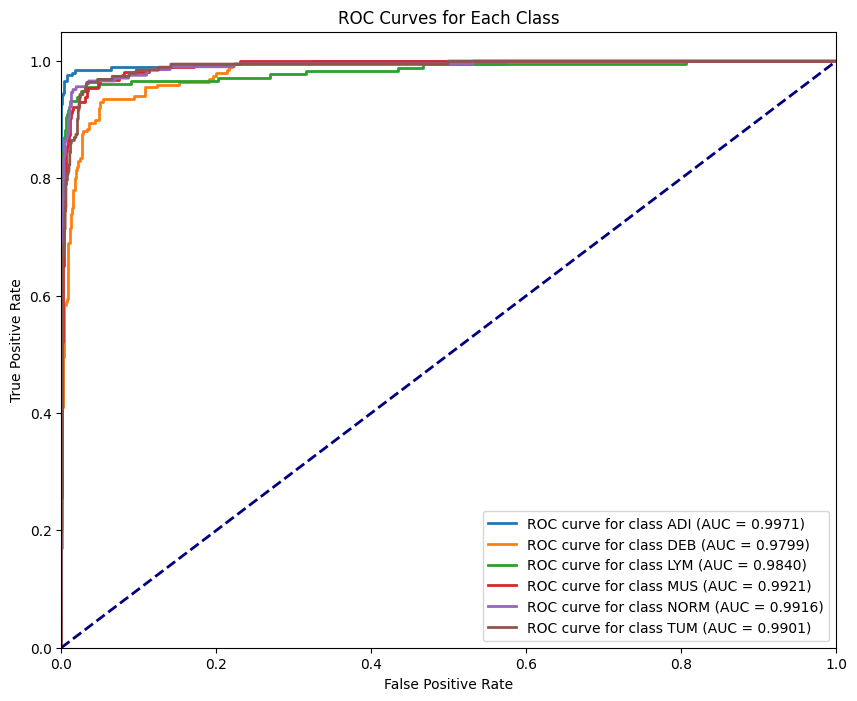

In [ ]:
#precision, recall, f1-score, AUC and ROC base on micro-average
class_names = ['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM']

# Initialize lists to store all predicted probabilities and labels
all_predictions = []
all_labels = []
all_probs = []

# Collect the predicted probabilities and true labels
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Get model outputs (logits)
        outputs = model(inputs)
        # Apply softmax to get probabilities
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        # Append predictions, probabilities, and labels
        all_predictions.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert to numpy arrays
all_predictions = np.array(all_predictions)
all_probs = np.array(all_probs)
all_labels = np.array(all_labels)

#Calculate precision, recall, and f1-score using micro-average for each class
for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)
    binary_preds = np.where(all_predictions == class_idx, 1, 0)

    # Calculate micro-average precision, recall, and f1-score for each class
    precision, recall, f1_score, _ = precision_recall_fscore_support(binary_labels, binary_preds, average='micro')

    # Print the results for each class
    print(f"Micro-average Precision for class {class_name}: {precision:.4f}")
    print(f"Micro-average Recall for class {class_name}: {recall:.4f}")
    print(f"Micro-average F1-Score for class {class_name}: {f1_score:.4f}")

#Calculate ROC and AUC for each class, and plot all ROC curves
plt.figure(figsize=(10, 8))

for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)

    # Calculate ROC curve and AUC for the current class
    fpr, tpr, _ = roc_curve(binary_labels, all_probs[:, class_idx])
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve for the current class
    plt.plot(fpr, tpr, lw=2, label=f'ROC curve for class {class_name} (AUC = {roc_auc:.4f})')

# Plot the diagonal line (chance level)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Configure plot
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Each Class')
plt.legend(loc="lower right")
plt.show()

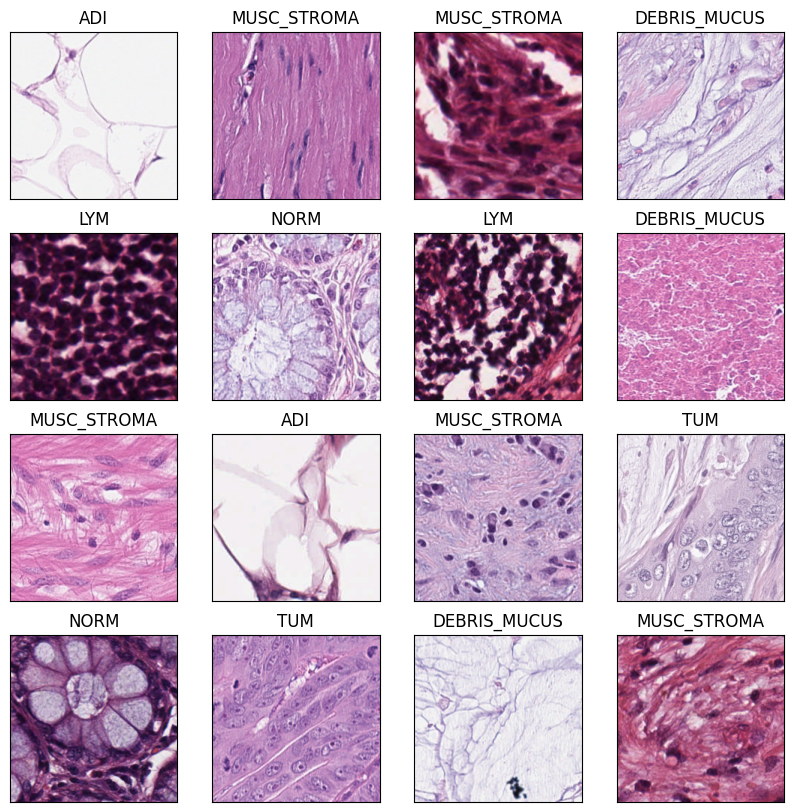

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
#resnet50(rotation)
def func_transform():
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ])

    return transform

transformed = func_transform()

full_dataset = datasets.ImageFolder(root='/content/demo_rotation', transform= transformed)

total_size = len(full_dataset)

train_size = int(0.8 * total_size)
test_size = total_size - train_size
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, )
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, )

plot_loader_ = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Visualise some examples
plt.figure(figsize=(10,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    ax.grid(False)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    batch = next(iter(plot_loader_))
    label = int(batch[1].numpy()[0])
    image = np.transpose(batch[0][0].numpy(), (1, 2, 0))
    #image = image * std +mean
    plt.imshow(image)
    plt.title(full_dataset.classes[label])
plt.show()

batch[1].numpy()[0]
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model_resnet.parameters()), lr=0.001)
model = model_resnet
model.to(device)

In [ ]:
train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist = train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True)

Epoch 1/30, loss 0.42649, test_loss 0.29178, accuracy 0.86856, test_accuracy 0.91667
Epoch 2/30, loss 0.23290, test_loss 0.19543, accuracy 0.92458, test_accuracy 0.93531
Epoch 3/30, loss 0.15509, test_loss 0.27316, accuracy 0.95240, test_accuracy 0.91667
Epoch 4/30, loss 0.11282, test_loss 0.26411, accuracy 0.96437, test_accuracy 0.92270
Epoch 5/30, loss 0.08849, test_loss 0.21062, accuracy 0.97252, test_accuracy 0.93586
Epoch 6/30, loss 0.05622, test_loss 0.20845, accuracy 0.98303, test_accuracy 0.94490
Epoch 7/30, loss 0.06048, test_loss 0.19675, accuracy 0.97990, test_accuracy 0.93969
Epoch 8/30, loss 0.04311, test_loss 0.17435, accuracy 0.98720, test_accuracy 0.95121
Epoch 9/30, loss 0.03944, test_loss 0.22922, accuracy 0.98708, test_accuracy 0.94189
Epoch 10/30, loss 0.02839, test_loss 0.22094, accuracy 0.99095, test_accuracy 0.93997
Epoch 11/30, loss 0.03429, test_loss 0.24401, accuracy 0.98875, test_accuracy 0.94627
Epoch 12/30, loss 0.04315, test_loss 0.25208, accuracy 0.98752,

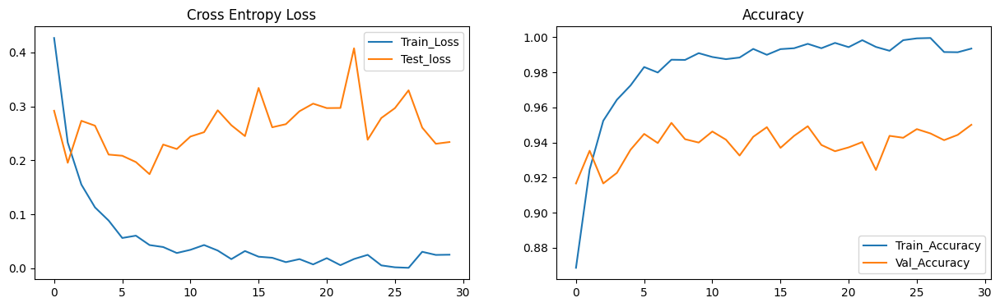

In [ ]:
plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, '/content/drive/MyDrive/res_rotation.png')

In [ ]:
model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')


all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)


Overall accuracy on test set: 95.1 %
Accuracy of ADI: 97.5 %
Accuracy of DEBRIS_MUCUS: 93.3 %
Accuracy of LYM: 92.3 %
Accuracy of MUSC_STROMA: 96.4 %
Accuracy of NORM: 96.3 %
Accuracy of TUM: 94.5 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     0.9851    0.9755    0.9803       204
         DEB     0.9000    0.9326    0.9160       193
         LYM     0.9505    0.9231    0.9366       208
         MUS     0.9298    0.9636    0.9464       220
        NORM     0.9786    0.9632    0.9708       190
         TUM     0.9661    0.9448    0.9553       181

    accuracy                         0.9507      1196
   macro avg     0.9517    0.9505    0.9509      1196
weighted avg     0.9513    0.9507    0.9508      1196



Micro-average Precision for class ADI: 0.9933
Micro-average Recall for class ADI: 0.9933
Micro-average F1-Score for class ADI: 0.9933
Micro-average Precision for class DEB: 0.9724
Micro-average Recall for class DEB: 0.9724
Micro-average F1-Score for class DEB: 0.9724
Micro-average Precision for class LYM: 0.9783
Micro-average Recall for class LYM: 0.9783
Micro-average F1-Score for class LYM: 0.9783
Micro-average Precision for class MUS: 0.9799
Micro-average Recall for class MUS: 0.9799
Micro-average F1-Score for class MUS: 0.9799
Micro-average Precision for class NORM: 0.9908
Micro-average Recall for class NORM: 0.9908
Micro-average F1-Score for class NORM: 0.9908
Micro-average Precision for class TUM: 0.9866
Micro-average Recall for class TUM: 0.9866
Micro-average F1-Score for class TUM: 0.9866


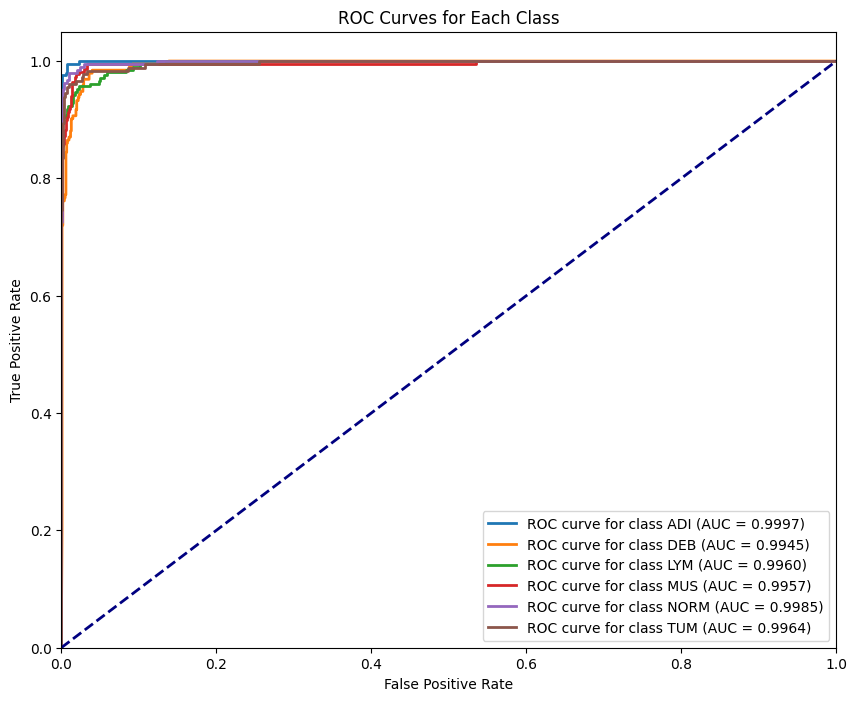

In [ ]:
#precision, recall, f1-score, AUC and ROC base on micro-average
class_names = ['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM']

# Initialize lists to store all predicted probabilities and labels
all_predictions = []
all_labels = []
all_probs = []

# Collect the predicted probabilities and true labels
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Get model outputs (logits)
        outputs = model(inputs)
        # Apply softmax to get probabilities
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        # Append predictions, probabilities, and labels
        all_predictions.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert to numpy arrays
all_predictions = np.array(all_predictions)
all_probs = np.array(all_probs)
all_labels = np.array(all_labels)

#Calculate precision, recall, and f1-score using micro-average for each class
for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)
    binary_preds = np.where(all_predictions == class_idx, 1, 0)

    # Calculate micro-average precision, recall, and f1-score for each class
    precision, recall, f1_score, _ = precision_recall_fscore_support(binary_labels, binary_preds, average='micro')

    # Print the results for each class
    print(f"Micro-average Precision for class {class_name}: {precision:.4f}")
    print(f"Micro-average Recall for class {class_name}: {recall:.4f}")
    print(f"Micro-average F1-Score for class {class_name}: {f1_score:.4f}")

#Calculate ROC and AUC for each class, and plot all ROC curves
plt.figure(figsize=(10, 8))

for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)

    # Calculate ROC curve and AUC for the current class
    fpr, tpr, _ = roc_curve(binary_labels, all_probs[:, class_idx])
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve for the current class
    plt.plot(fpr, tpr, lw=2, label=f'ROC curve for class {class_name} (AUC = {roc_auc:.4f})')

# Plot the diagonal line (chance level)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Configure plot
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Each Class')
plt.legend(loc="lower right")
plt.show()

In [ ]:
#Gaussian+Macenko
dataset_path = '/content/demo_macenko'
save_base_path = '/content/gaussian+Macenko'


for root, dirs, files in os.walk(dataset_path):
    for file in files:

        if file.endswith((".tif", ".png")):
            file_path = os.path.join(root, file)
            image = Image.open(file_path)
            processed_gaussian = apply_gaussian_filter(image)


            relative_path = os.path.relpath(root, dataset_path)
            save_folder = os.path.join(save_base_path, relative_path)

            if not os.path.exists(save_folder):
                os.makedirs(save_folder)


            save_extension = file.split('.')[-1].lower()
            save_path = os.path.join(save_folder, file)


            if save_extension == 'tif':
                processed_gaussian.save(save_path, format='TIFF')
            elif save_extension == 'png':
                processed_gaussian.save(save_path, format='PNG')

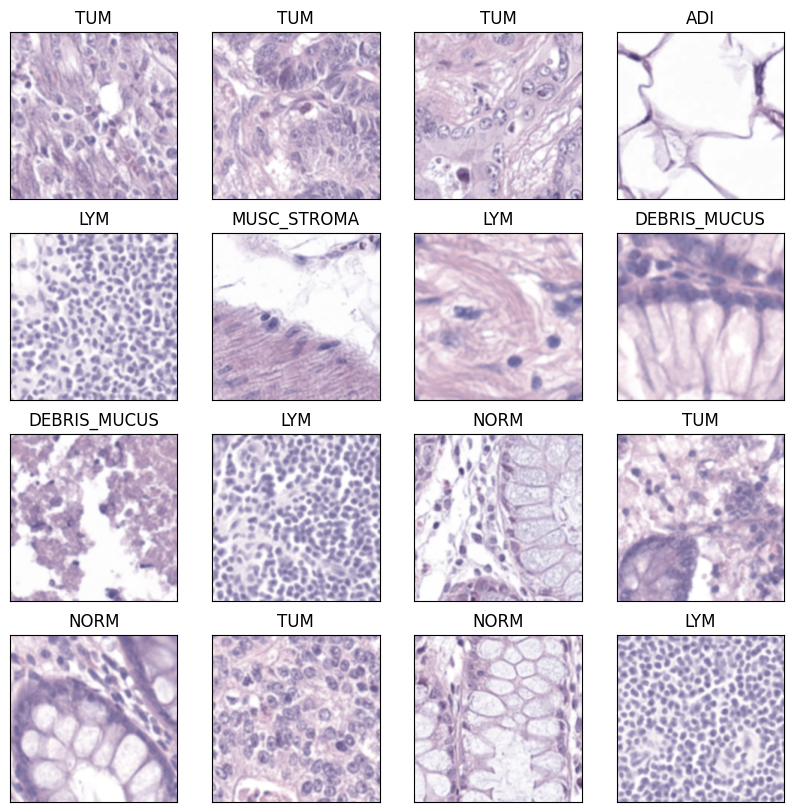

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [ ]:
#VGG(gaussian+macenko)
def func_transform():
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ])

    return transform

transformed = func_transform()

full_dataset = datasets.ImageFolder(root='/content/gaussian+Macenko', transform= transformed)

total_size = len(full_dataset)

train_size = int(0.8 * total_size)
test_size = total_size - train_size
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, )
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, )

plot_loader_ = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Visualise some examples
plt.figure(figsize=(10,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    ax.grid(False)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    batch = next(iter(plot_loader_))
    label = int(batch[1].numpy()[0])
    image = np.transpose(batch[0][0].numpy(), (1, 2, 0))
    #image = image * std +mean
    plt.imshow(image)
    plt.title(full_dataset.classes[label])
plt.show()

batch[1].numpy()[0]

optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model_VGG16.parameters()), lr=0.00033)
model = model_VGG16
model.to(device)

In [ ]:
train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist = train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True)

Epoch 1/30, loss 0.32582, test_loss 0.27816, accuracy 0.90238, test_accuracy 0.92524
Epoch 2/30, loss 0.24296, test_loss 0.32177, accuracy 0.92583, test_accuracy 0.90057
Epoch 3/30, loss 0.21366, test_loss 0.36572, accuracy 0.93771, test_accuracy 0.87993
Epoch 4/30, loss 0.16010, test_loss 0.43670, accuracy 0.94426, test_accuracy 0.86513
Epoch 5/30, loss 0.16858, test_loss 0.35283, accuracy 0.95042, test_accuracy 0.91619
Epoch 6/30, loss 0.13016, test_loss 0.31141, accuracy 0.96604, test_accuracy 0.92434
Epoch 7/30, loss 0.09570, test_loss 0.29589, accuracy 0.97021, test_accuracy 0.91283
Epoch 8/30, loss 0.06675, test_loss 0.25775, accuracy 0.98021, test_accuracy 0.93017
Epoch 9/30, loss 0.06669, test_loss 0.29137, accuracy 0.98146, test_accuracy 0.92688
Epoch 10/30, loss 0.08068, test_loss 0.35984, accuracy 0.97708, test_accuracy 0.90304
Epoch 11/30, loss 0.09614, test_loss 0.32802, accuracy 0.97771, test_accuracy 0.90468
Epoch 12/30, loss 0.10532, test_loss 0.24211, accuracy 0.96718,

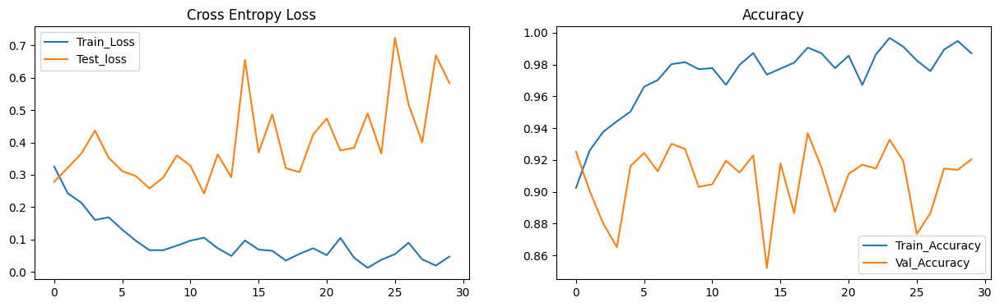

In [ ]:
plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, '/content/drive/MyDrive/vgg_gaussian+Macenko.png')

In [ ]:
model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')

all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)


Overall accuracy on test set: 92.1 %
Accuracy of ADI: 96.4 %
Accuracy of DEBRIS_MUCUS: 91.9 %
Accuracy of LYM: 90.0 %
Accuracy of MUSC_STROMA: 94.2 %
Accuracy of NORM: 89.4 %
Accuracy of TUM: 90.5 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     0.9737    0.9635    0.9686       192
         DEB     0.8391    0.9190    0.8773       210
         LYM     0.9293    0.9000    0.9144       190
         MUS     0.9028    0.9420    0.9220       207
        NORM     0.9487    0.8937    0.9204       207
         TUM     0.9500    0.9048    0.9268       189

    accuracy                         0.9205      1195
   macro avg     0.9239    0.9205    0.9216      1195
weighted avg     0.9226    0.9205    0.9209      1195



In [ ]:
model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')

all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)


Overall accuracy on test set: 92.1 %
Accuracy of ADI: 96.4 %
Accuracy of DEBRIS_MUCUS: 91.9 %
Accuracy of LYM: 90.0 %
Accuracy of MUSC_STROMA: 94.2 %
Accuracy of NORM: 89.4 %
Accuracy of TUM: 90.5 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     0.9737    0.9635    0.9686       192
         DEB     0.8391    0.9190    0.8773       210
         LYM     0.9293    0.9000    0.9144       190
         MUS     0.9028    0.9420    0.9220       207
        NORM     0.9487    0.8937    0.9204       207
         TUM     0.9500    0.9048    0.9268       189

    accuracy                         0.9205      1195
   macro avg     0.9239    0.9205    0.9216      1195
weighted avg     0.9226    0.9205    0.9209      1195



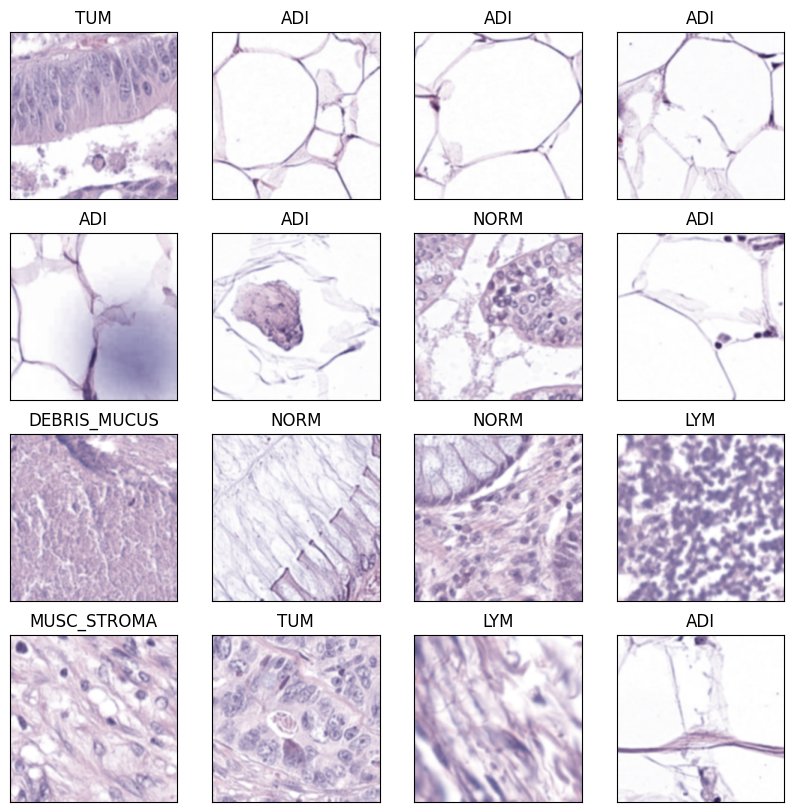

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
#Resnet(Gaussian+macenko)
def func_transform():
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ])

    return transform

transformed = func_transform()

full_dataset = datasets.ImageFolder(root='/content/gaussian+Macenko', transform= transformed)

total_size = len(full_dataset)

train_size = int(0.8 * total_size)
test_size = total_size - train_size
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, )
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, )

plot_loader_ = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Visualise some examples
plt.figure(figsize=(10,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    ax.grid(False)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    batch = next(iter(plot_loader_))
    label = int(batch[1].numpy()[0])
    image = np.transpose(batch[0][0].numpy(), (1, 2, 0))
    #image = image * std +mean
    plt.imshow(image)
    plt.title(full_dataset.classes[label])
plt.show()

batch[1].numpy()[0]
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model_resnet.parameters()), lr=0.001)
model = model_resnet
model.to(device)

In [ ]:
train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist = train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True)

Epoch 1/30, loss 0.19503, test_loss 0.13585, accuracy 0.93896, test_accuracy 0.95970
Epoch 2/30, loss 0.06616, test_loss 0.15524, accuracy 0.97947, test_accuracy 0.95477
Epoch 3/30, loss 0.03298, test_loss 0.16518, accuracy 0.99000, test_accuracy 0.95970
Epoch 4/30, loss 0.02949, test_loss 0.16449, accuracy 0.98979, test_accuracy 0.95970
Epoch 5/30, loss 0.01888, test_loss 0.23841, accuracy 0.99375, test_accuracy 0.95395
Epoch 6/30, loss 0.03155, test_loss 0.18452, accuracy 0.98958, test_accuracy 0.95641
Epoch 7/30, loss 0.02632, test_loss 0.15331, accuracy 0.99144, test_accuracy 0.95641
Epoch 8/30, loss 0.02172, test_loss 0.15958, accuracy 0.99197, test_accuracy 0.95724
Epoch 9/30, loss 0.01911, test_loss 0.21048, accuracy 0.99396, test_accuracy 0.95559
Epoch 10/30, loss 0.00958, test_loss 0.20824, accuracy 0.99676, test_accuracy 0.95641
Epoch 11/30, loss 0.01084, test_loss 0.20177, accuracy 0.99604, test_accuracy 0.95230
Epoch 12/30, loss 0.00531, test_loss 0.32120, accuracy 0.99813,

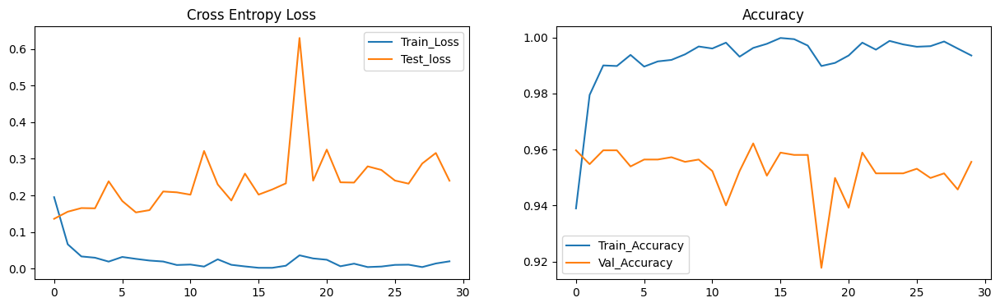

In [ ]:
plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, '/content/drive/MyDrive/res_gaussian+macenko.png')

In [ ]:
model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')


all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)

Overall accuracy on test set: 95.5 %
Accuracy of ADI: 96.9 %
Accuracy of DEBRIS_MUCUS: 92.4 %
Accuracy of LYM: 97.6 %
Accuracy of MUSC_STROMA: 94.5 %
Accuracy of NORM: 94.2 %
Accuracy of TUM: 97.1 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     1.0000    0.9689    0.9842       193
         DEB     0.8986    0.9242    0.9112       211
         LYM     0.9409    0.9764    0.9583       212
         MUS     0.9773    0.9451    0.9609       182
        NORM     0.9889    0.9418    0.9648       189
         TUM     0.9395    0.9712    0.9551       208

    accuracy                         0.9548      1195
   macro avg     0.9575    0.9546    0.9558      1195
weighted avg     0.9559    0.9548    0.9550      1195



Micro-average Precision for class ADI: 0.9950
Micro-average Recall for class ADI: 0.9950
Micro-average F1-Score for class ADI: 0.9950
Micro-average Precision for class DEB: 0.9682
Micro-average Recall for class DEB: 0.9682
Micro-average F1-Score for class DEB: 0.9682
Micro-average Precision for class LYM: 0.9849
Micro-average Recall for class LYM: 0.9849
Micro-average F1-Score for class LYM: 0.9849
Micro-average Precision for class MUS: 0.9883
Micro-average Recall for class MUS: 0.9883
Micro-average F1-Score for class MUS: 0.9883
Micro-average Precision for class NORM: 0.9891
Micro-average Recall for class NORM: 0.9891
Micro-average F1-Score for class NORM: 0.9891
Micro-average Precision for class TUM: 0.9841
Micro-average Recall for class TUM: 0.9841
Micro-average F1-Score for class TUM: 0.9841


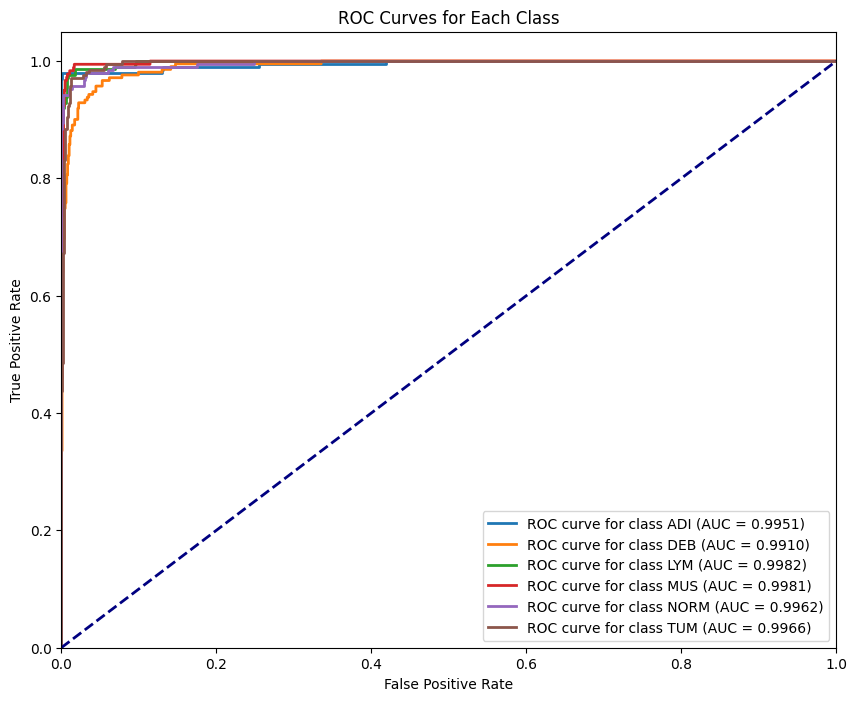

In [ ]:
#precision, recall, f1-score, AUC and ROC base on micro-average
class_names = ['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM']

# Initialize lists to store all predicted probabilities and labels
all_predictions = []
all_labels = []
all_probs = []

# Collect the predicted probabilities and true labels
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Get model outputs (logits)
        outputs = model(inputs)
        # Apply softmax to get probabilities
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        # Append predictions, probabilities, and labels
        all_predictions.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert to numpy arrays
all_predictions = np.array(all_predictions)
all_probs = np.array(all_probs)
all_labels = np.array(all_labels)

#Calculate precision, recall, and f1-score using micro-average for each class
for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)
    binary_preds = np.where(all_predictions == class_idx, 1, 0)

    # Calculate micro-average precision, recall, and f1-score for each class
    precision, recall, f1_score, _ = precision_recall_fscore_support(binary_labels, binary_preds, average='micro')

    # Print the results for each class
    print(f"Micro-average Precision for class {class_name}: {precision:.4f}")
    print(f"Micro-average Recall for class {class_name}: {recall:.4f}")
    print(f"Micro-average F1-Score for class {class_name}: {f1_score:.4f}")

#Calculate ROC and AUC for each class, and plot all ROC curves
plt.figure(figsize=(10, 8))

for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)

    # Calculate ROC curve and AUC for the current class
    fpr, tpr, _ = roc_curve(binary_labels, all_probs[:, class_idx])
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve for the current class
    plt.plot(fpr, tpr, lw=2, label=f'ROC curve for class {class_name} (AUC = {roc_auc:.4f})')

# Plot the diagonal line (chance level)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Configure plot
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Each Class')
plt.legend(loc="lower right")
plt.show()


In [ ]:
#Gaussian+randomly rotation
dataset_path = '/content/demo_rotation'
save_base_path = '/content/gaussian+rotation'


for root, dirs, files in os.walk(dataset_path):
    for file in files:

        if file.endswith((".tif", ".png")):
            file_path = os.path.join(root, file)
            image = Image.open(file_path)
            processed_gaussian = apply_gaussian_filter(image)


            relative_path = os.path.relpath(root, dataset_path)
            save_folder = os.path.join(save_base_path, relative_path)

            if not os.path.exists(save_folder):
                os.makedirs(save_folder)


            save_extension = file.split('.')[-1].lower()
            save_path = os.path.join(save_folder, file)


            if save_extension == 'tif':
                processed_gaussian.save(save_path, format='TIFF')
            elif save_extension == 'png':
                processed_gaussian.save(save_path, format='PNG')


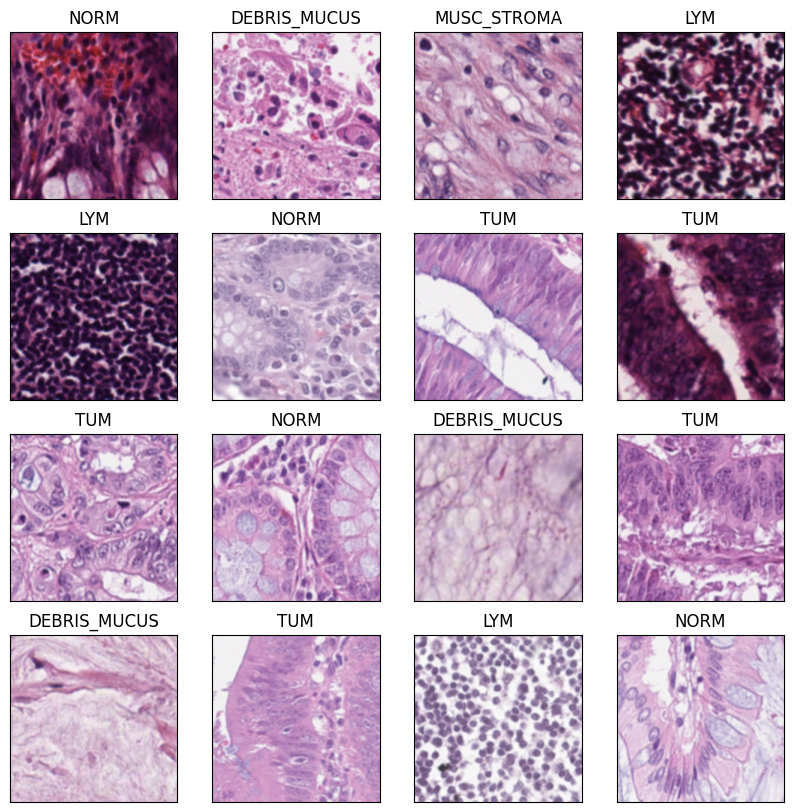

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [ ]:
#VGG(Gaussian+rotation)
def func_transform():
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ])

    return transform

transformed = func_transform()

full_dataset = datasets.ImageFolder(root='/content/gaussian+rotation', transform= transformed)

total_size = len(full_dataset)

train_size = int(0.8 * total_size)
test_size = total_size - train_size
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, )
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, )

plot_loader_ = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Visualise some examples
plt.figure(figsize=(10,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    ax.grid(False)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    batch = next(iter(plot_loader_))
    label = int(batch[1].numpy()[0])
    image = np.transpose(batch[0][0].numpy(), (1, 2, 0))
    #image = image * std +mean
    plt.imshow(image)
    plt.title(full_dataset.classes[label])
plt.show()

batch[1].numpy()[0]

optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model_VGG16.parameters()), lr=0.00033)
model = model_VGG16
model.to(device)


In [ ]:
train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist = train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True)

Epoch 1/30, loss 0.17765, test_loss 0.18411, accuracy 0.95699, test_accuracy 0.95148
Epoch 2/30, loss 0.08949, test_loss 0.12389, accuracy 0.97271, test_accuracy 0.96628
Epoch 3/30, loss 0.06112, test_loss 0.41568, accuracy 0.98354, test_accuracy 0.89008
Epoch 4/30, loss 0.08621, test_loss 0.29872, accuracy 0.97522, test_accuracy 0.91968
Epoch 5/30, loss 0.02701, test_loss 0.19348, accuracy 0.99417, test_accuracy 0.96875
Epoch 6/30, loss 0.05164, test_loss 0.22735, accuracy 0.98604, test_accuracy 0.94984
Epoch 7/30, loss 0.03459, test_loss 0.42718, accuracy 0.98979, test_accuracy 0.94243
Epoch 8/30, loss 0.06272, test_loss 0.12638, accuracy 0.98240, test_accuracy 0.96299
Epoch 9/30, loss 0.06614, test_loss 0.18184, accuracy 0.98042, test_accuracy 0.95477
Epoch 10/30, loss 0.06904, test_loss 0.18468, accuracy 0.98125, test_accuracy 0.95559
Epoch 11/30, loss 0.04590, test_loss 0.21959, accuracy 0.98687, test_accuracy 0.95312
Epoch 12/30, loss 0.06004, test_loss 0.14331, accuracy 0.98583,

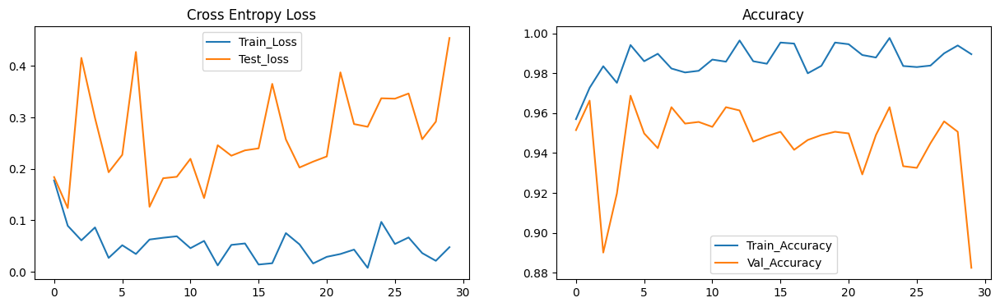

In [ ]:
plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, '/content/drive/MyDrive/vgg_gaussian+rotation.png')

In [ ]:
model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')

all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)


Overall accuracy on test set: 88.0 %
Accuracy of ADI: 100.0 %
Accuracy of DEBRIS_MUCUS: 84.5 %
Accuracy of LYM: 94.3 %
Accuracy of MUSC_STROMA: 93.0 %
Accuracy of NORM: 92.7 %
Accuracy of TUM: 64.3 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     0.9568    1.0000    0.9779       177
         DEB     0.8065    0.8454    0.8255       207
         LYM     0.9296    0.9429    0.9362       210
         MUS     0.7457    0.9301    0.8278       186
        NORM     0.9273    0.9273    0.9273       220
         TUM     0.9767    0.6429    0.7754       196

    accuracy                         0.8804      1196
   macro avg     0.8904    0.8814    0.8783      1196
weighted avg     0.8910    0.8804    0.8783      1196



Micro-average Precision for class ADI: 0.9933
Micro-average Recall for class ADI: 0.9933
Micro-average F1-Score for class ADI: 0.9933
Micro-average Precision for class DEB: 0.9381
Micro-average Recall for class DEB: 0.9381
Micro-average F1-Score for class DEB: 0.9381
Micro-average Precision for class LYM: 0.9774
Micro-average Recall for class LYM: 0.9774
Micro-average F1-Score for class LYM: 0.9774
Micro-average Precision for class MUS: 0.9398
Micro-average Recall for class MUS: 0.9398
Micro-average F1-Score for class MUS: 0.9398
Micro-average Precision for class NORM: 0.9732
Micro-average Recall for class NORM: 0.9732
Micro-average F1-Score for class NORM: 0.9732
Micro-average Precision for class TUM: 0.9390
Micro-average Recall for class TUM: 0.9390
Micro-average F1-Score for class TUM: 0.9390


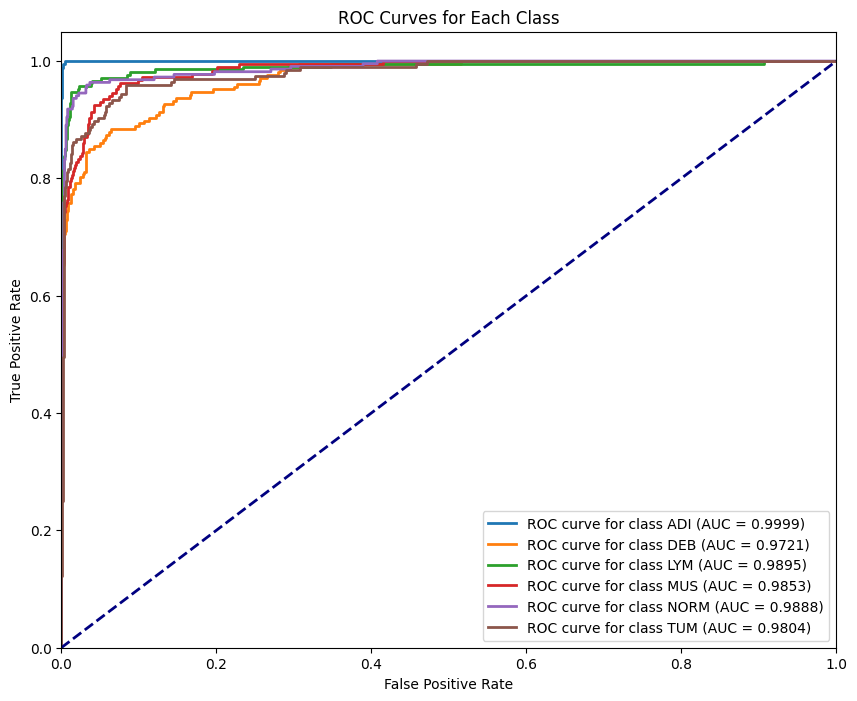

In [ ]:
#precision, recall, f1-score, AUC and ROC base on micro-average
class_names = ['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM']

# Initialize lists to store all predicted probabilities and labels
all_predictions = []
all_labels = []
all_probs = []

# Collect the predicted probabilities and true labels
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Get model outputs (logits)
        outputs = model(inputs)
        # Apply softmax to get probabilities
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        # Append predictions, probabilities, and labels
        all_predictions.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert to numpy arrays
all_predictions = np.array(all_predictions)
all_probs = np.array(all_probs)
all_labels = np.array(all_labels)

#Calculate precision, recall, and f1-score using micro-average for each class
for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)
    binary_preds = np.where(all_predictions == class_idx, 1, 0)

    # Calculate micro-average precision, recall, and f1-score for each class
    precision, recall, f1_score, _ = precision_recall_fscore_support(binary_labels, binary_preds, average='micro')

    # Print the results for each class
    print(f"Micro-average Precision for class {class_name}: {precision:.4f}")
    print(f"Micro-average Recall for class {class_name}: {recall:.4f}")
    print(f"Micro-average F1-Score for class {class_name}: {f1_score:.4f}")

#Calculate ROC and AUC for each class, and plot all ROC curves
plt.figure(figsize=(10, 8))

for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)

    # Calculate ROC curve and AUC for the current class
    fpr, tpr, _ = roc_curve(binary_labels, all_probs[:, class_idx])
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve for the current class
    plt.plot(fpr, tpr, lw=2, label=f'ROC curve for class {class_name} (AUC = {roc_auc:.4f})')

# Plot the diagonal line (chance level)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Configure plot
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Each Class')
plt.legend(loc="lower right")
plt.show()

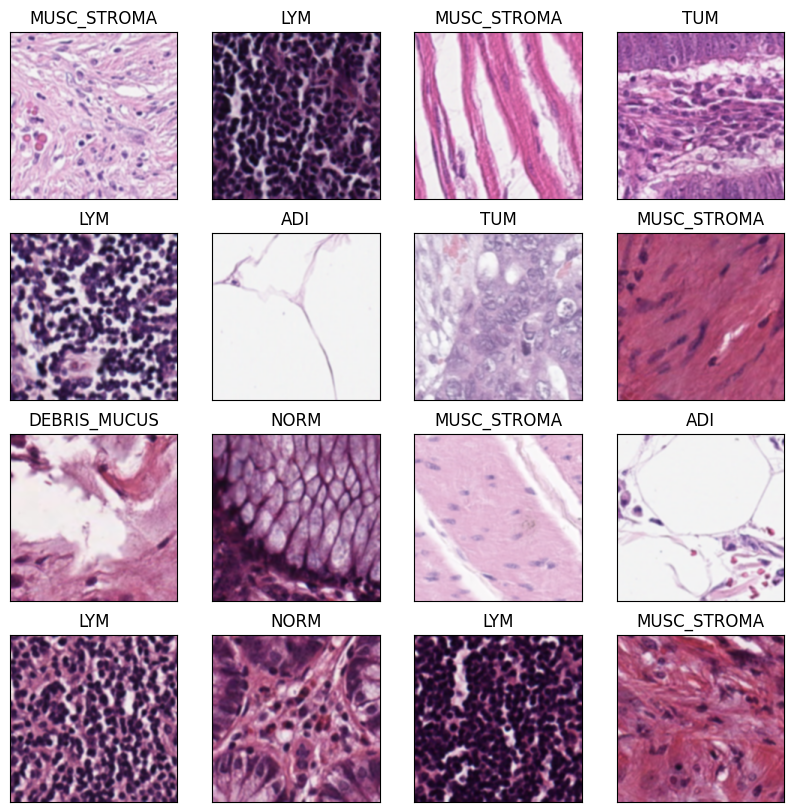

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
#Resnet(Gaussian+rotation)
def func_transform():
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ])

    return transform

transformed = func_transform()

full_dataset = datasets.ImageFolder(root='/content/gaussian+rotation', transform= transformed)

total_size = len(full_dataset)

train_size = int(0.8 * total_size)
test_size = total_size - train_size
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, )
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, )

plot_loader_ = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Visualise some examples
plt.figure(figsize=(10,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    ax.grid(False)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    batch = next(iter(plot_loader_))
    label = int(batch[1].numpy()[0])
    image = np.transpose(batch[0][0].numpy(), (1, 2, 0))
    #image = image * std +mean
    plt.imshow(image)
    plt.title(full_dataset.classes[label])
plt.show()

batch[1].numpy()[0]
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model_resnet.parameters()), lr=0.001)
model = model_resnet
model.to(device)

In [ ]:
train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist = train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True)

Epoch 1/30, loss 0.07282, test_loss 0.04551, accuracy 0.97553, test_accuracy 0.98766
Epoch 2/30, loss 0.02259, test_loss 0.03473, accuracy 0.99271, test_accuracy 0.99095
Epoch 3/30, loss 0.01320, test_loss 0.02899, accuracy 0.99542, test_accuracy 0.99424
Epoch 4/30, loss 0.01049, test_loss 0.03309, accuracy 0.99729, test_accuracy 0.99342
Epoch 5/30, loss 0.01551, test_loss 0.05048, accuracy 0.99449, test_accuracy 0.99260
Epoch 6/30, loss 0.02523, test_loss 0.04216, accuracy 0.99157, test_accuracy 0.99013
Epoch 7/30, loss 0.00589, test_loss 0.04581, accuracy 0.99750, test_accuracy 0.98766
Epoch 8/30, loss 0.01751, test_loss 0.06596, accuracy 0.99542, test_accuracy 0.98191
Epoch 9/30, loss 0.01552, test_loss 0.05519, accuracy 0.99562, test_accuracy 0.98684
Epoch 10/30, loss 0.00601, test_loss 0.04787, accuracy 0.99792, test_accuracy 0.98849
Epoch 11/30, loss 0.00471, test_loss 0.05736, accuracy 0.99875, test_accuracy 0.99013
Epoch 12/30, loss 0.01379, test_loss 0.05479, accuracy 0.99708,

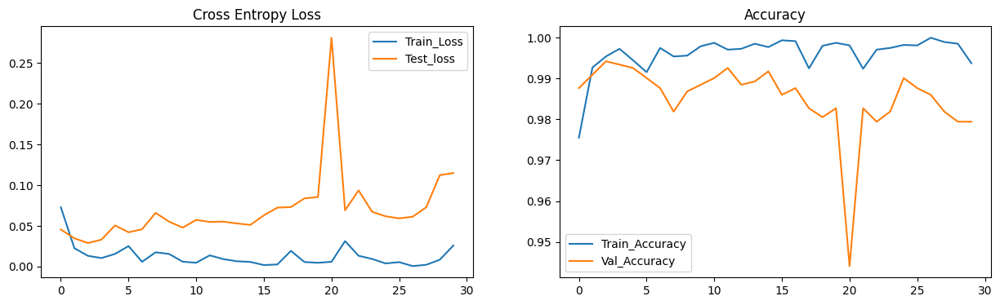

In [ ]:
plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, '/content/drive/MyDrive/res_gaussian+rotation.png')

In [ ]:
model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')


all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)


Overall accuracy on test set: 97.9 %
Accuracy of ADI: 97.0 %
Accuracy of DEBRIS_MUCUS: 97.2 %
Accuracy of LYM: 98.6 %
Accuracy of MUSC_STROMA: 97.3 %
Accuracy of NORM: 99.0 %
Accuracy of TUM: 98.3 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     1.0000    0.9698    0.9847       199
         DEB     0.9579    0.9716    0.9647       211
         LYM     0.9861    0.9861    0.9861       216
         MUS     0.9733    0.9733    0.9733       187
        NORM     0.9810    0.9904    0.9856       208
         TUM     0.9773    0.9829    0.9801       175

    accuracy                         0.9791      1196
   macro avg     0.9793    0.9790    0.9791      1196
weighted avg     0.9793    0.9791    0.9791      1196



Micro-average Precision for class ADI: 0.9950
Micro-average Recall for class ADI: 0.9950
Micro-average F1-Score for class ADI: 0.9950
Micro-average Precision for class DEB: 0.9875
Micro-average Recall for class DEB: 0.9875
Micro-average F1-Score for class DEB: 0.9875
Micro-average Precision for class LYM: 0.9950
Micro-average Recall for class LYM: 0.9950
Micro-average F1-Score for class LYM: 0.9950
Micro-average Precision for class MUS: 0.9916
Micro-average Recall for class MUS: 0.9916
Micro-average F1-Score for class MUS: 0.9916
Micro-average Precision for class NORM: 0.9950
Micro-average Recall for class NORM: 0.9950
Micro-average F1-Score for class NORM: 0.9950
Micro-average Precision for class TUM: 0.9941
Micro-average Recall for class TUM: 0.9941
Micro-average F1-Score for class TUM: 0.9941


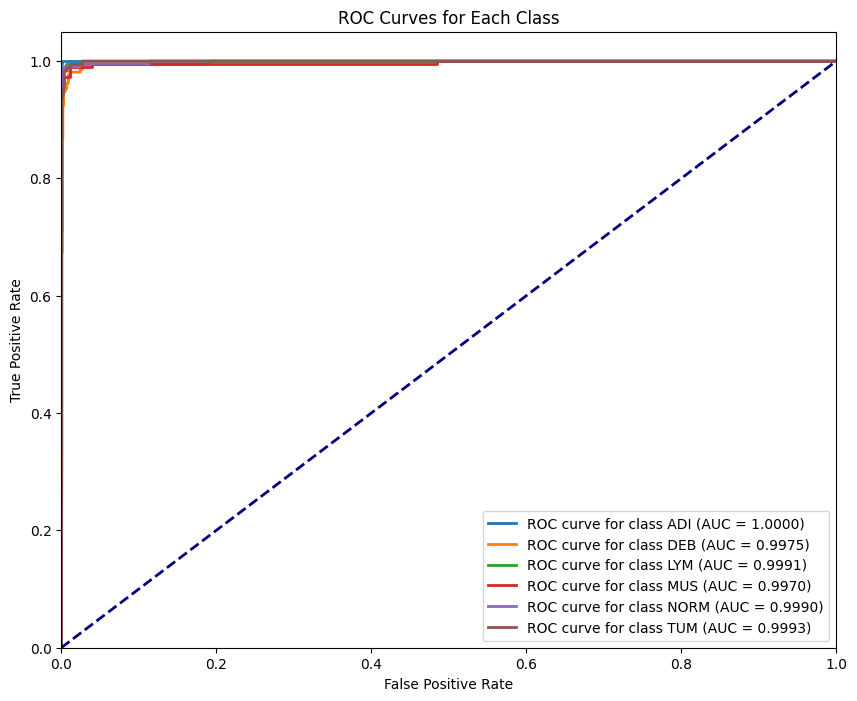

In [ ]:
#precision, recall, f1-score, AUC and ROC base on micro-average
class_names = ['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM']

# Initialize lists to store all predicted probabilities and labels
all_predictions = []
all_labels = []
all_probs = []

# Collect the predicted probabilities and true labels
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Get model outputs (logits)
        outputs = model(inputs)
        # Apply softmax to get probabilities
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        # Append predictions, probabilities, and labels
        all_predictions.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert to numpy arrays
all_predictions = np.array(all_predictions)
all_probs = np.array(all_probs)
all_labels = np.array(all_labels)

#Calculate precision, recall, and f1-score using micro-average for each class
for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)
    binary_preds = np.where(all_predictions == class_idx, 1, 0)

    # Calculate micro-average precision, recall, and f1-score for each class
    precision, recall, f1_score, _ = precision_recall_fscore_support(binary_labels, binary_preds, average='micro')

    # Print the results for each class
    print(f"Micro-average Precision for class {class_name}: {precision:.4f}")
    print(f"Micro-average Recall for class {class_name}: {recall:.4f}")
    print(f"Micro-average F1-Score for class {class_name}: {f1_score:.4f}")

#Calculate ROC and AUC for each class, and plot all ROC curves
plt.figure(figsize=(10, 8))

for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)

    # Calculate ROC curve and AUC for the current class
    fpr, tpr, _ = roc_curve(binary_labels, all_probs[:, class_idx])
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve for the current class
    plt.plot(fpr, tpr, lw=2, label=f'ROC curve for class {class_name} (AUC = {roc_auc:.4f})')

# Plot the diagonal line (chance level)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Configure plot
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Each Class')
plt.legend(loc="lower right")
plt.show()


In [ ]:
#Macenko+Randomly rotation
def batch_stain_normalization(input_folder, output_folder):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    normalizer = Macenko_Normalizer()

    reference_image_filename = "/content/reference_image_1.png"
    reference_image = np.array(Image.open(reference_image_filename))

    normalizer.fit(reference_image)

    skipped_images_count = 0

    for root, dirs, files in os.walk(input_folder):
        relative_path = os.path.relpath(root, input_folder)
        output_subfolder = os.path.join(output_folder, relative_path)

        if not os.path.exists(output_subfolder):
            os.makedirs(output_subfolder)

        for filename in files:
            if filename.lower().endswith((".jpg", ".jpeg", ".png", ".tif", ".tiff")):
                input_image_path = os.path.join(root, filename)
                output_image_path = os.path.join(output_subfolder, filename)

                image = np.array(Image.open(input_image_path))

                try:
                    normalized_image = normalizer.transform(image)

                    Image.fromarray(normalized_image).save(output_image_path)
                    print(f"Normalized image saved to {output_image_path}")

                except (np.linalg.LinAlgError, ValueError) as e:
                    print(f"Skipping image {filename} due to error: {e}")
                    shutil.copy(input_image_path, output_image_path)
                    print(f"Original image copied to {output_image_path}")
                    skipped_images_count += 1

    print(f"\nBatch stain normalization completed. {skipped_images_count} images were skipped and copied without processing.")

input_images_folder = "/content/demo_rotation"
output_folder = "/content/demo_macenko+rotation"

batch_stain_normalization(input_images_folder, output_folder)

流式输出内容被截断，只能显示最后 5000 行内容。
Normalized image saved to /content/demo_macenko+rotation/MUSC_STROMA/MUS-LQRYWADN.tif
Normalized image saved to /content/demo_macenko+rotation/MUSC_STROMA/STR-NFMQECAH.tif
Normalized image saved to /content/demo_macenko+rotation/MUSC_STROMA/CRC_MUSC_STROMA_2081.png
Normalized image saved to /content/demo_macenko+rotation/MUSC_STROMA/STR-MDHTCRYQ.tif
Normalized image saved to /content/demo_macenko+rotation/MUSC_STROMA/MUS-DLWASQNN.tif
Normalized image saved to /content/demo_macenko+rotation/MUSC_STROMA/MUS-LREKWNFR.tif
Normalized image saved to /content/demo_macenko+rotation/MUSC_STROMA/STR-NLEDPKIH.tif
Normalized image saved to /content/demo_macenko+rotation/MUSC_STROMA/STR-KDCILLYH.tif
Normalized image saved to /content/demo_macenko+rotation/MUSC_STROMA/STR-WRNNGLYA.tif
Normalized image saved to /content/demo_macenko+rotation/MUSC_STROMA/STR-HQVLGCSV.tif
Normalized image saved to /content/demo_macenko+rotation/MUSC_STROMA/STR-HNLACAVR.tif
Normalized image sa

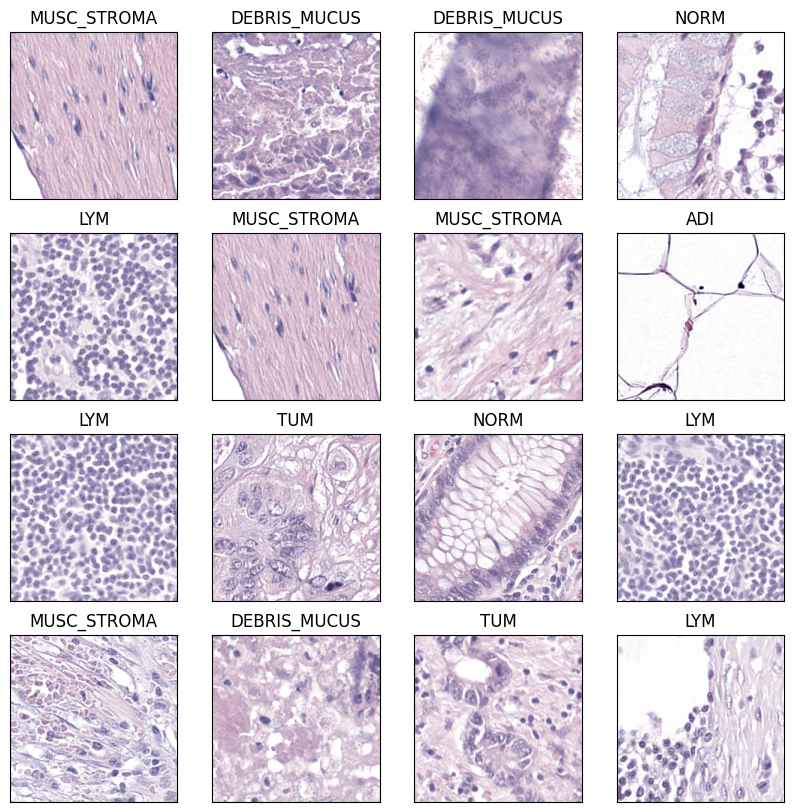

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [ ]:
#VGG(macenko+rotation)
def func_transform():
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ])

    return transform

transformed = func_transform()

full_dataset = datasets.ImageFolder(root='/content/demo_macenko+rotation', transform= transformed)

total_size = len(full_dataset)

train_size = int(0.8 * total_size)
test_size = total_size - train_size
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, )
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, )

plot_loader_ = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Visualise some examples
plt.figure(figsize=(10,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    ax.grid(False)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    batch = next(iter(plot_loader_))
    label = int(batch[1].numpy()[0])
    image = np.transpose(batch[0][0].numpy(), (1, 2, 0))
    #image = image * std +mean
    plt.imshow(image)
    plt.title(full_dataset.classes[label])
plt.show()

batch[1].numpy()[0]
optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model_VGG16.parameters()), lr=0.00033)
model = model_VGG16
model.to(device)

In [ ]:
train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist = train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True)

Epoch 1/30, loss 0.16901, test_loss 0.09440, accuracy 0.95479, test_accuracy 0.98026
Epoch 2/30, loss 0.08150, test_loss 0.17027, accuracy 0.98000, test_accuracy 0.96135
Epoch 3/30, loss 0.10773, test_loss 0.20112, accuracy 0.97490, test_accuracy 0.95038
Epoch 4/30, loss 0.05008, test_loss 0.07711, accuracy 0.98542, test_accuracy 0.97944
Epoch 5/30, loss 0.05261, test_loss 0.13626, accuracy 0.98615, test_accuracy 0.96135
Epoch 6/30, loss 0.04026, test_loss 0.10643, accuracy 0.98875, test_accuracy 0.97862
Epoch 7/30, loss 0.02915, test_loss 0.10245, accuracy 0.99187, test_accuracy 0.97944
Epoch 8/30, loss 0.10430, test_loss 0.16166, accuracy 0.97188, test_accuracy 0.96135
Epoch 9/30, loss 0.23436, test_loss 0.44200, accuracy 0.93803, test_accuracy 0.87664
Epoch 10/30, loss 0.11445, test_loss 0.15238, accuracy 0.97208, test_accuracy 0.95312
Epoch 11/30, loss 0.03550, test_loss 0.11211, accuracy 0.98833, test_accuracy 0.96985
Epoch 12/30, loss 0.03546, test_loss 0.14138, accuracy 0.99021,

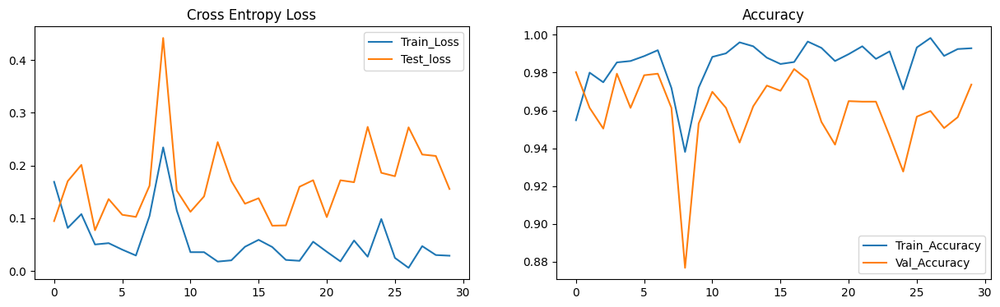

In [ ]:
plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, '/content/drive/MyDrive/vgg_macenko+rotation.png')

In [ ]:
model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')

all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)


Overall accuracy on test set: 97.3 %
Accuracy of ADI: 98.5 %
Accuracy of DEBRIS_MUCUS: 97.9 %
Accuracy of LYM: 96.8 %
Accuracy of MUSC_STROMA: 93.8 %
Accuracy of NORM: 98.5 %
Accuracy of TUM: 98.4 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     0.9801    0.9850    0.9825       200
         DEB     0.9436    0.9787    0.9608       188
         LYM     0.9859    0.9677    0.9767       217
         MUS     0.9784    0.9378    0.9577       193
        NORM     0.9758    0.9854    0.9806       205
         TUM     0.9744    0.9845    0.9794       193

    accuracy                         0.9732      1196
   macro avg     0.9730    0.9732    0.9730      1196
weighted avg     0.9735    0.9732    0.9732      1196



Micro-average Precision for class ADI: 0.9941
Micro-average Recall for class ADI: 0.9941
Micro-average F1-Score for class ADI: 0.9941
Micro-average Precision for class DEB: 0.9875
Micro-average Recall for class DEB: 0.9875
Micro-average F1-Score for class DEB: 0.9875
Micro-average Precision for class LYM: 0.9916
Micro-average Recall for class LYM: 0.9916
Micro-average F1-Score for class LYM: 0.9916
Micro-average Precision for class MUS: 0.9866
Micro-average Recall for class MUS: 0.9866
Micro-average F1-Score for class MUS: 0.9866
Micro-average Precision for class NORM: 0.9933
Micro-average Recall for class NORM: 0.9933
Micro-average F1-Score for class NORM: 0.9933
Micro-average Precision for class TUM: 0.9933
Micro-average Recall for class TUM: 0.9933
Micro-average F1-Score for class TUM: 0.9933


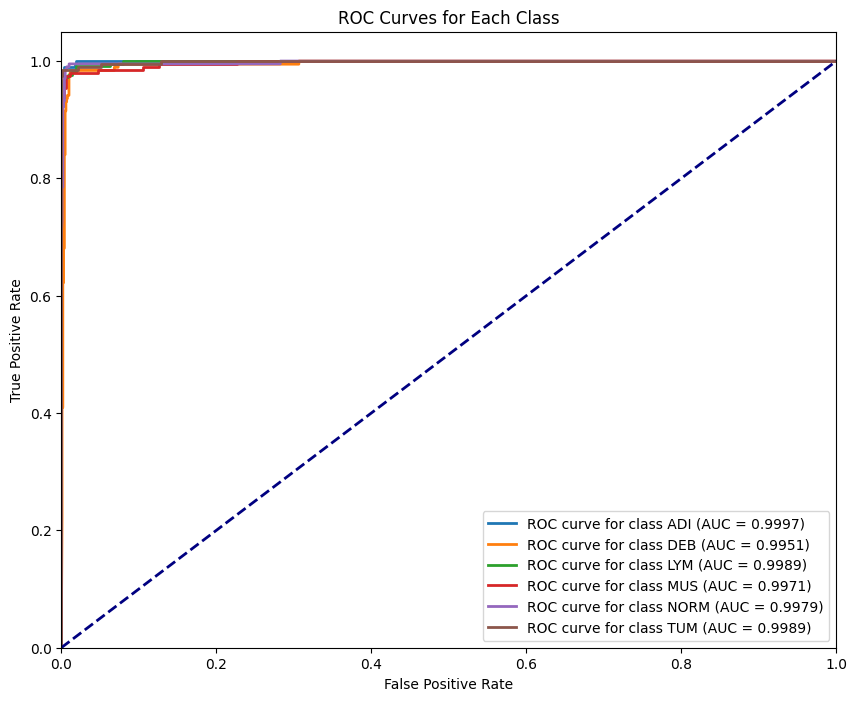

In [ ]:
#precision, recall, f1-score, AUC and ROC base on micro-average
class_names = ['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM']

# Initialize lists to store all predicted probabilities and labels
all_predictions = []
all_labels = []
all_probs = []

# Collect the predicted probabilities and true labels
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Get model outputs (logits)
        outputs = model(inputs)
        # Apply softmax to get probabilities
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        # Append predictions, probabilities, and labels
        all_predictions.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert to numpy arrays
all_predictions = np.array(all_predictions)
all_probs = np.array(all_probs)
all_labels = np.array(all_labels)

#Calculate precision, recall, and f1-score using micro-average for each class
for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)
    binary_preds = np.where(all_predictions == class_idx, 1, 0)

    # Calculate micro-average precision, recall, and f1-score for each class
    precision, recall, f1_score, _ = precision_recall_fscore_support(binary_labels, binary_preds, average='micro')

    # Print the results for each class
    print(f"Micro-average Precision for class {class_name}: {precision:.4f}")
    print(f"Micro-average Recall for class {class_name}: {recall:.4f}")
    print(f"Micro-average F1-Score for class {class_name}: {f1_score:.4f}")

#Calculate ROC and AUC for each class, and plot all ROC curves
plt.figure(figsize=(10, 8))

for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)

    # Calculate ROC curve and AUC for the current class
    fpr, tpr, _ = roc_curve(binary_labels, all_probs[:, class_idx])
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve for the current class
    plt.plot(fpr, tpr, lw=2, label=f'ROC curve for class {class_name} (AUC = {roc_auc:.4f})')

# Plot the diagonal line (chance level)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Configure plot
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Each Class')
plt.legend(loc="lower right")
plt.show()

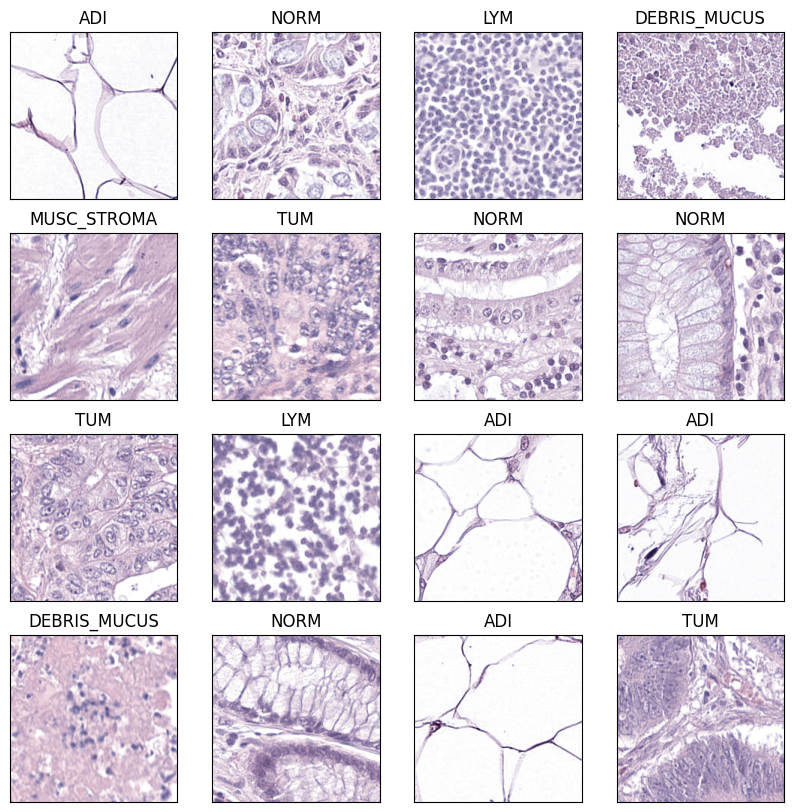

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
#Res(Macenko+rotation)
def func_transform():
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ])

    return transform

transformed = func_transform()

full_dataset = datasets.ImageFolder(root='/content/demo_macenko+rotation', transform= transformed)

total_size = len(full_dataset)

train_size = int(0.8 * total_size)
test_size = total_size - train_size
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, )
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, )

plot_loader_ = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Visualise some examples
plt.figure(figsize=(10,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    ax.grid(False)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    batch = next(iter(plot_loader_))
    label = int(batch[1].numpy()[0])
    image = np.transpose(batch[0][0].numpy(), (1, 2, 0))
    #image = image * std +mean
    plt.imshow(image)
    plt.title(full_dataset.classes[label])
plt.show()

batch[1].numpy()[0]
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model_resnet.parameters()), lr=0.001)
model = model_resnet
model.to(device)

In [ ]:
train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist = train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True)

Epoch 1/30, loss 0.09229, test_loss 0.05082, accuracy 0.97521, test_accuracy 0.98684
Epoch 2/30, loss 0.02073, test_loss 0.02595, accuracy 0.99396, test_accuracy 0.99260
Epoch 3/30, loss 0.01048, test_loss 0.04197, accuracy 0.99708, test_accuracy 0.98849
Epoch 4/30, loss 0.00686, test_loss 0.04524, accuracy 0.99813, test_accuracy 0.99013
Epoch 5/30, loss 0.01203, test_loss 0.03298, accuracy 0.99687, test_accuracy 0.99095
Epoch 6/30, loss 0.01476, test_loss 0.05710, accuracy 0.99500, test_accuracy 0.98520
Epoch 7/30, loss 0.01850, test_loss 0.04378, accuracy 0.99500, test_accuracy 0.98849
Epoch 8/30, loss 0.01897, test_loss 0.04347, accuracy 0.99438, test_accuracy 0.99342
Epoch 9/30, loss 0.01171, test_loss 0.03481, accuracy 0.99729, test_accuracy 0.98684
Epoch 10/30, loss 0.00639, test_loss 0.02651, accuracy 0.99813, test_accuracy 0.98931
Epoch 11/30, loss 0.00278, test_loss 0.02164, accuracy 0.99896, test_accuracy 0.99013
Epoch 12/30, loss 0.00083, test_loss 0.02218, accuracy 1.00000,

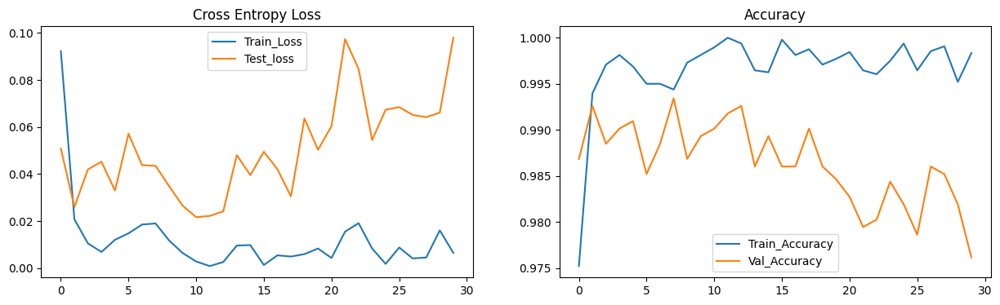

In [ ]:
plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, '/content/drive/MyDrive/res_macenko+rotation.png')

In [ ]:
model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')


all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)


Overall accuracy on test set: 97.6 %
Accuracy of ADI: 99.5 %
Accuracy of DEBRIS_MUCUS: 96.6 %
Accuracy of LYM: 94.9 %
Accuracy of MUSC_STROMA: 98.2 %
Accuracy of NORM: 97.0 %
Accuracy of TUM: 99.5 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     0.9949    0.9949    0.9949       196
         DEB     0.9378    0.9655    0.9515       203
         LYM     1.0000    0.9490    0.9738       196
         MUS     0.9726    0.9816    0.9771       217
        NORM     0.9948    0.9697    0.9821       198
         TUM     0.9585    0.9946    0.9763       186

    accuracy                         0.9758      1196
   macro avg     0.9764    0.9759    0.9759      1196
weighted avg     0.9763    0.9758    0.9758      1196



Micro-average Precision for class ADI: 0.9983
Micro-average Recall for class ADI: 0.9983
Micro-average F1-Score for class ADI: 0.9983
Micro-average Precision for class DEB: 0.9833
Micro-average Recall for class DEB: 0.9833
Micro-average F1-Score for class DEB: 0.9833
Micro-average Precision for class LYM: 0.9916
Micro-average Recall for class LYM: 0.9916
Micro-average F1-Score for class LYM: 0.9916
Micro-average Precision for class MUS: 0.9916
Micro-average Recall for class MUS: 0.9916
Micro-average F1-Score for class MUS: 0.9916
Micro-average Precision for class NORM: 0.9941
Micro-average Recall for class NORM: 0.9941
Micro-average F1-Score for class NORM: 0.9941
Micro-average Precision for class TUM: 0.9925
Micro-average Recall for class TUM: 0.9925
Micro-average F1-Score for class TUM: 0.9925


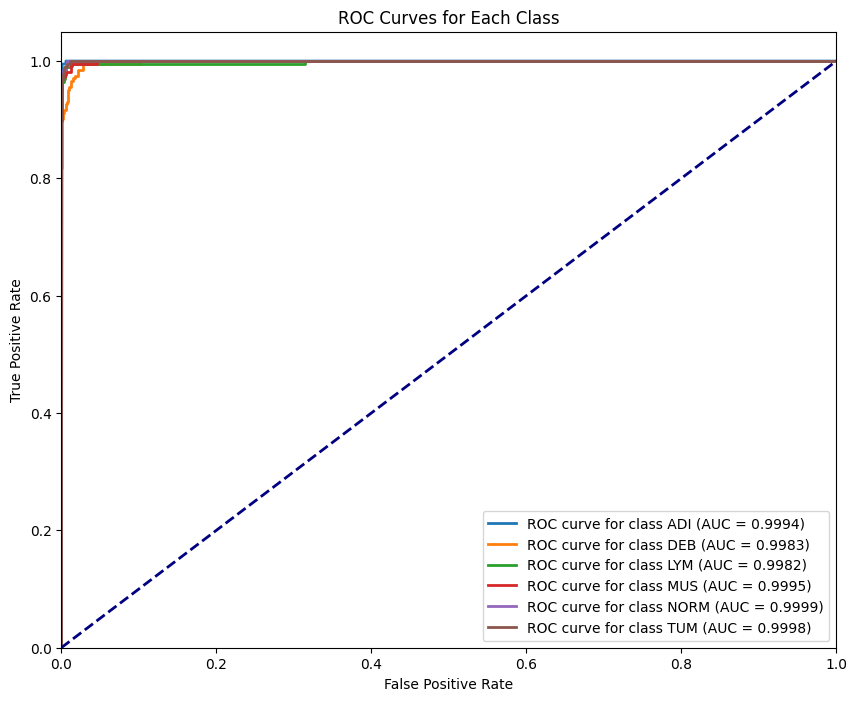

In [ ]:
#precision, recall, f1-score, AUC and ROC base on micro-average
class_names = ['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM']

# Initialize lists to store all predicted probabilities and labels
all_predictions = []
all_labels = []
all_probs = []

# Collect the predicted probabilities and true labels
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Get model outputs (logits)
        outputs = model(inputs)
        # Apply softmax to get probabilities
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        # Append predictions, probabilities, and labels
        all_predictions.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert to numpy arrays
all_predictions = np.array(all_predictions)
all_probs = np.array(all_probs)
all_labels = np.array(all_labels)

#Calculate precision, recall, and f1-score using micro-average for each class
for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)
    binary_preds = np.where(all_predictions == class_idx, 1, 0)

    # Calculate micro-average precision, recall, and f1-score for each class
    precision, recall, f1_score, _ = precision_recall_fscore_support(binary_labels, binary_preds, average='micro')

    # Print the results for each class
    print(f"Micro-average Precision for class {class_name}: {precision:.4f}")
    print(f"Micro-average Recall for class {class_name}: {recall:.4f}")
    print(f"Micro-average F1-Score for class {class_name}: {f1_score:.4f}")

#Calculate ROC and AUC for each class, and plot all ROC curves
plt.figure(figsize=(10, 8))

for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)

    # Calculate ROC curve and AUC for the current class
    fpr, tpr, _ = roc_curve(binary_labels, all_probs[:, class_idx])
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve for the current class
    plt.plot(fpr, tpr, lw=2, label=f'ROC curve for class {class_name} (AUC = {roc_auc:.4f})')

# Plot the diagonal line (chance level)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Configure plot
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Each Class')
plt.legend(loc="lower right")
plt.show()

In [ ]:
#Gaussian+randomly rotation+Macenko
def batch_stain_normalization(input_folder, output_folder):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    normalizer = Macenko_Normalizer()

    reference_image_filename = "/content/reference_image_1.png"
    reference_image = np.array(Image.open(reference_image_filename))

    normalizer.fit(reference_image)

    skipped_images_count = 0

    for root, dirs, files in os.walk(input_folder):
        relative_path = os.path.relpath(root, input_folder)
        output_subfolder = os.path.join(output_folder, relative_path)

        if not os.path.exists(output_subfolder):
            os.makedirs(output_subfolder)

        for filename in files:
            if filename.lower().endswith((".jpg", ".jpeg", ".png", ".tif", ".tiff")):
                input_image_path = os.path.join(root, filename)
                output_image_path = os.path.join(output_subfolder, filename)

                image = np.array(Image.open(input_image_path))

                try:
                    normalized_image = normalizer.transform(image)

                    Image.fromarray(normalized_image).save(output_image_path)
                    print(f"Normalized image saved to {output_image_path}")

                except (np.linalg.LinAlgError, ValueError) as e:
                    print(f"Skipping image {filename} due to error: {e}")
                    shutil.copy(input_image_path, output_image_path)
                    print(f"Original image copied to {output_image_path}")
                    skipped_images_count += 1

    print(f"\nBatch stain normalization completed. {skipped_images_count} images were skipped and copied without processing.")

input_images_folder = "/content/gaussian+rotation"
output_folder = "/content/demo_macenko+rotation+Gaussian"

batch_stain_normalization(input_images_folder, output_folder)

Normalized image saved to /content/demo_macenko+rotation+Gaussian/MUSC_STROMA/MUS-KCETVKSH.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/MUSC_STROMA/MUS-AFAMCLNG.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/MUSC_STROMA/STR-WCINFFKH.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/MUSC_STROMA/STR-YQEDNSKQ.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/MUSC_STROMA/MUS-QKNFWCRV.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/MUSC_STROMA/STR-YQHSFSGR.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/MUSC_STROMA/MUS-TEMVCVMS.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/MUSC_STROMA/MUS-QVLDKNEP.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/MUSC_STROMA/STR-IENKHAFF.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/MUSC_STROMA/STR-TDTMLPFH.tif
Normalized image saved to /content/demo_macenko+ro

/usr/local/lib/python3.10/dist-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-9-8ab1405443f0>:5: RuntimeWarning: Degrees of freedom <= 0 for slice
  _, V = np.linalg.eigh(np.cov(OD, rowvar=False))
/usr/local/lib/python3.10/dist-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/usr/local/lib/python3.10/dist-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Normalized image saved to /content/demo_macenko+rotation+Gaussian/ADI/16031_CRC-Prim-HE-03_012.tif_Row_751_Col_2701.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/ADI/ADI-NSQHTKPF.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/ADI/CRC_ADI_1518.png
Normalized image saved to /content/demo_macenko+rotation+Gaussian/ADI/ADI-DEVIPILT.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/ADI/ADI-GSYICRDL.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/ADI/ADI-MEVFMMTT.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/ADI/ADI-QCEMRLWF.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/ADI/ADI-ICLLESDR.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/ADI/ADI-MAFQTQGI.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/ADI/ADI-IMRQIEKG.tif
Normalized image saved to /content/demo_macenko+rotation+Gaussian/ADI/CRC_ADI_1401.png
Normalized

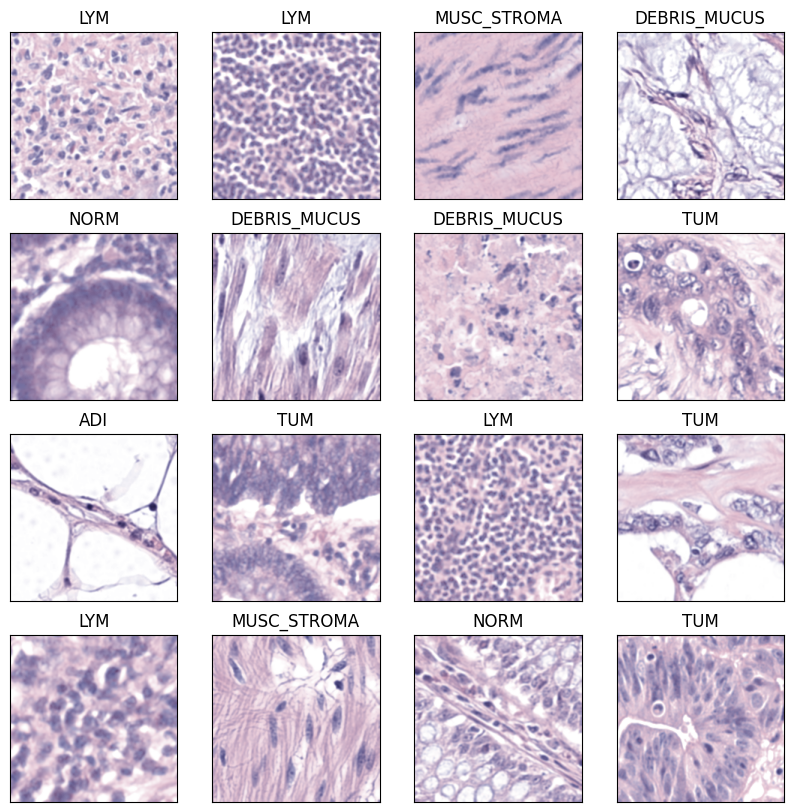

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [ ]:
#VGG(macenko+rotation+Gaussian)
def func_transform():
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ])

    return transform

transformed = func_transform()

full_dataset = datasets.ImageFolder(root='/content/demo_macenko+rotation+Gaussian', transform= transformed)

total_size = len(full_dataset)

train_size = int(0.8 * total_size)
test_size = total_size - train_size
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, )
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, )

plot_loader_ = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Visualise some examples
plt.figure(figsize=(10,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    ax.grid(False)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    batch = next(iter(plot_loader_))
    label = int(batch[1].numpy()[0])
    image = np.transpose(batch[0][0].numpy(), (1, 2, 0))
    #image = image * std +mean
    plt.imshow(image)
    plt.title(full_dataset.classes[label])
plt.show()

batch[1].numpy()[0]
optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model_VGG16.parameters()), lr=0.00033)
model = model_VGG16
model.to(device)

In [ ]:
train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist = train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True)

Epoch 1/30, loss 0.10955, test_loss 0.07776, accuracy 0.97979, test_accuracy 0.98026
Epoch 2/30, loss 0.07026, test_loss 0.06676, accuracy 0.98396, test_accuracy 0.98520
Epoch 3/30, loss 0.04268, test_loss 0.15548, accuracy 0.99062, test_accuracy 0.95806
Epoch 4/30, loss 0.03358, test_loss 0.35695, accuracy 0.98917, test_accuracy 0.96546
Epoch 5/30, loss 0.13200, test_loss 0.09424, accuracy 0.96583, test_accuracy 0.98191
Epoch 6/30, loss 0.03231, test_loss 0.06889, accuracy 0.99146, test_accuracy 0.98438
Epoch 7/30, loss 0.07300, test_loss 0.14331, accuracy 0.98167, test_accuracy 0.97725
Epoch 8/30, loss 0.02153, test_loss 0.07106, accuracy 0.99479, test_accuracy 0.99178
Epoch 9/30, loss 0.00039, test_loss 0.08572, accuracy 1.00000, test_accuracy 0.99013
Epoch 10/30, loss 0.08460, test_loss 0.06691, accuracy 0.98083, test_accuracy 0.97944
Epoch 11/30, loss 0.01703, test_loss 0.08579, accuracy 0.99500, test_accuracy 0.98520
Epoch 12/30, loss 0.08427, test_loss 0.16028, accuracy 0.97979,

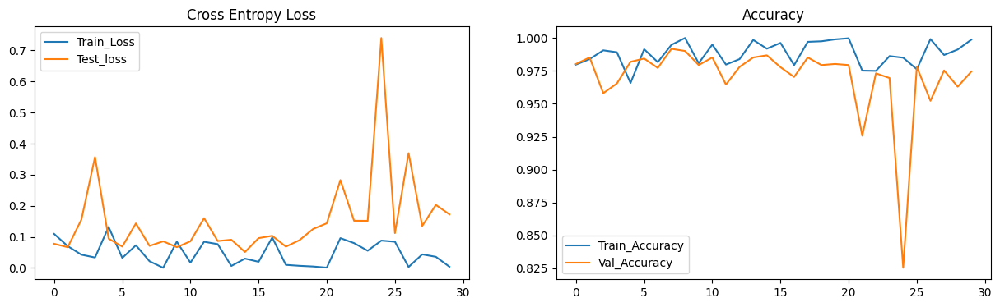

In [ ]:
plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, '/content/drive/MyDrive/vgg_Gaussian+Macenko+rotation.png')

In [ ]:
model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')

all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)

Overall accuracy on test set: 97.4 %
Accuracy of ADI: 99.5 %
Accuracy of DEBRIS_MUCUS: 94.9 %
Accuracy of LYM: 99.0 %
Accuracy of MUSC_STROMA: 95.3 %
Accuracy of NORM: 96.2 %
Accuracy of TUM: 99.5 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     0.9896    0.9948    0.9922       191
         DEB     0.9543    0.9495    0.9519       198
         LYM     0.9718    0.9904    0.9810       209
         MUS     0.9837    0.9526    0.9679       190
        NORM     0.9950    0.9615    0.9780       208
         TUM     0.9522    0.9950    0.9731       200

    accuracy                         0.9741      1196
   macro avg     0.9744    0.9740    0.9740      1196
weighted avg     0.9744    0.9741    0.9741      1196



Micro-average Precision for class ADI: 0.9975
Micro-average Recall for class ADI: 0.9975
Micro-average F1-Score for class ADI: 0.9975
Micro-average Precision for class DEB: 0.9841
Micro-average Recall for class DEB: 0.9841
Micro-average F1-Score for class DEB: 0.9841
Micro-average Precision for class LYM: 0.9933
Micro-average Recall for class LYM: 0.9933
Micro-average F1-Score for class LYM: 0.9933
Micro-average Precision for class MUS: 0.9900
Micro-average Recall for class MUS: 0.9900
Micro-average F1-Score for class MUS: 0.9900
Micro-average Precision for class NORM: 0.9925
Micro-average Recall for class NORM: 0.9925
Micro-average F1-Score for class NORM: 0.9925
Micro-average Precision for class TUM: 0.9908
Micro-average Recall for class TUM: 0.9908
Micro-average F1-Score for class TUM: 0.9908


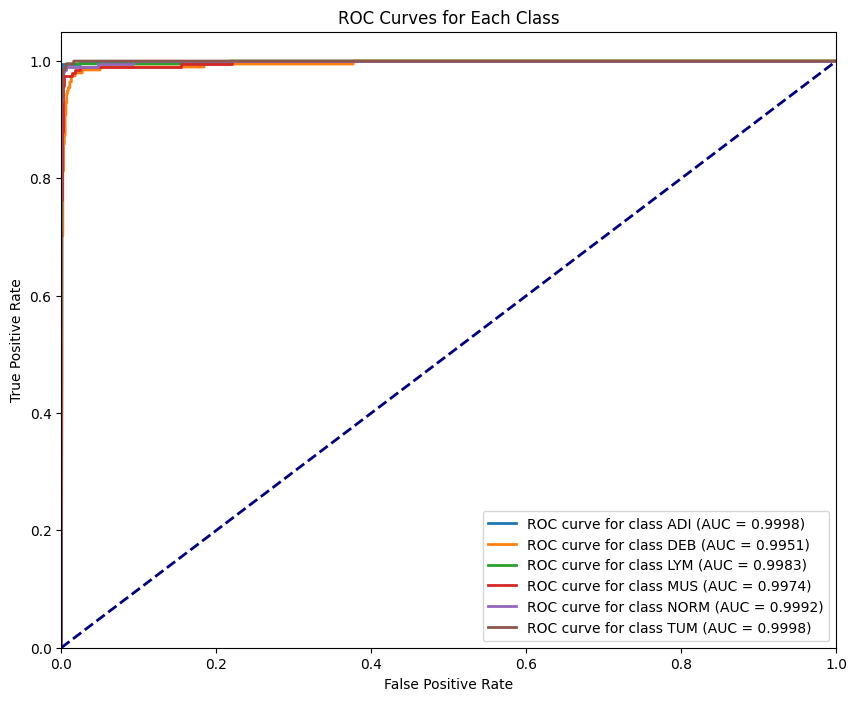

In [ ]:
#precision, recall, f1-score, AUC and ROC base on micro-average
class_names = ['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM']

# Initialize lists to store all predicted probabilities and labels
all_predictions = []
all_labels = []
all_probs = []

# Collect the predicted probabilities and true labels
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Get model outputs (logits)
        outputs = model(inputs)
        # Apply softmax to get probabilities
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        # Append predictions, probabilities, and labels
        all_predictions.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert to numpy arrays
all_predictions = np.array(all_predictions)
all_probs = np.array(all_probs)
all_labels = np.array(all_labels)

#Calculate precision, recall, and f1-score using micro-average for each class
for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)
    binary_preds = np.where(all_predictions == class_idx, 1, 0)

    # Calculate micro-average precision, recall, and f1-score for each class
    precision, recall, f1_score, _ = precision_recall_fscore_support(binary_labels, binary_preds, average='micro')

    # Print the results for each class
    print(f"Micro-average Precision for class {class_name}: {precision:.4f}")
    print(f"Micro-average Recall for class {class_name}: {recall:.4f}")
    print(f"Micro-average F1-Score for class {class_name}: {f1_score:.4f}")

#Calculate ROC and AUC for each class, and plot all ROC curves
plt.figure(figsize=(10, 8))

for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)

    # Calculate ROC curve and AUC for the current class
    fpr, tpr, _ = roc_curve(binary_labels, all_probs[:, class_idx])
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve for the current class
    plt.plot(fpr, tpr, lw=2, label=f'ROC curve for class {class_name} (AUC = {roc_auc:.4f})')

# Plot the diagonal line (chance level)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Configure plot
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Each Class')
plt.legend(loc="lower right")
plt.show()

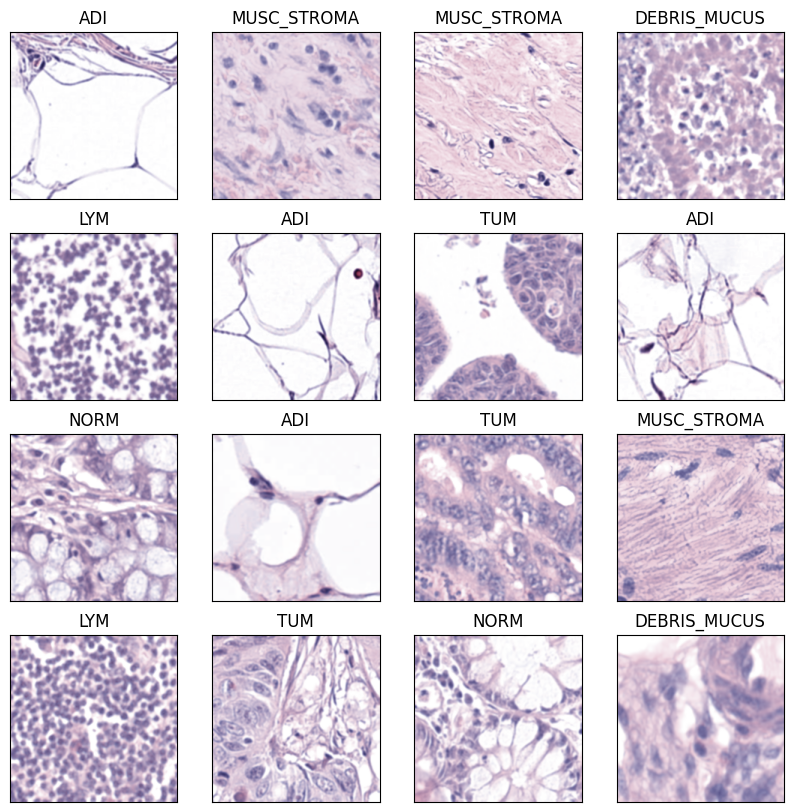

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
#resnet50(rotation+macenko+gaussian)
def func_transform():
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ])

    return transform

transformed = func_transform()

full_dataset = datasets.ImageFolder(root='/content/demo_macenko+rotation+Gaussian', transform= transformed)

total_size = len(full_dataset)

train_size = int(0.8 * total_size)
test_size = total_size - train_size
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, )
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, )

plot_loader_ = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Visualise some examples
plt.figure(figsize=(10,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    ax.grid(False)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    batch = next(iter(plot_loader_))
    label = int(batch[1].numpy()[0])
    image = np.transpose(batch[0][0].numpy(), (1, 2, 0))
    #image = image * std +mean
    plt.imshow(image)
    plt.title(full_dataset.classes[label])
plt.show()

batch[1].numpy()[0]
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model_resnet.parameters()), lr=0.001)
model = model_resnet
model.to(device)


In [ ]:
train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist = train_model(model, criterion, optimizer, scheduler, train_loader, test_loader, verbose=True)

Epoch 1/30, loss 0.03209, test_loss 0.03765, accuracy 0.99125, test_accuracy 0.99424
Epoch 2/30, loss 0.01403, test_loss 0.03526, accuracy 0.99583, test_accuracy 0.99424
Epoch 3/30, loss 0.01424, test_loss 0.04554, accuracy 0.99782, test_accuracy 0.99260
Epoch 4/30, loss 0.00825, test_loss 0.03435, accuracy 0.99729, test_accuracy 0.99342
Epoch 5/30, loss 0.00576, test_loss 0.05226, accuracy 0.99813, test_accuracy 0.98766
Epoch 6/30, loss 0.00531, test_loss 0.05035, accuracy 0.99813, test_accuracy 0.99342
Epoch 7/30, loss 0.00688, test_loss 0.04734, accuracy 0.99833, test_accuracy 0.99260
Epoch 8/30, loss 0.00895, test_loss 0.04642, accuracy 0.99813, test_accuracy 0.99178
Epoch 9/30, loss 0.00326, test_loss 0.05681, accuracy 0.99875, test_accuracy 0.99095
Epoch 10/30, loss 0.01046, test_loss 0.05545, accuracy 0.99708, test_accuracy 0.99342
Epoch 11/30, loss 0.01245, test_loss 0.05770, accuracy 0.99562, test_accuracy 0.99178
Epoch 12/30, loss 0.01508, test_loss 0.07077, accuracy 0.99813,

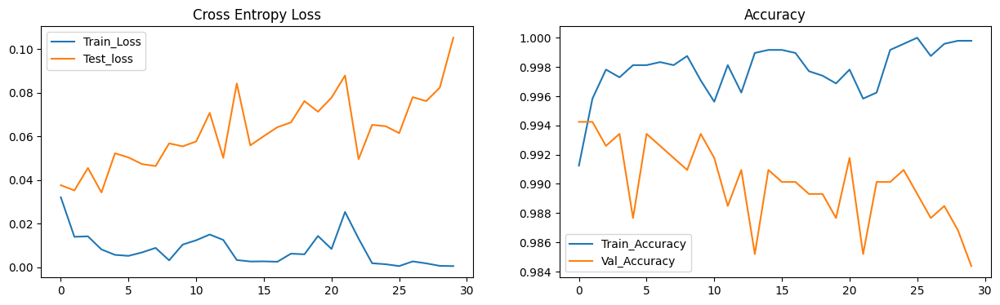

In [ ]:
plot_hist(train_loss_hist, test_loss_hist, train_acc_hist, test_acc_hist, '/content/drive/MyDrive/res_macenko+gaussian+rotation.png')

In [ ]:
model.eval()

with torch.no_grad():
    n_correct=0
    n_samples=0

    n_class_correct = [0 for i in range(len(full_dataset.classes))]
    n_class_sample = [0 for i in range(len(full_dataset.classes))]

    for inputs, labels in test_loader:
        # Send to device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)

        # Predictions
        _, preds = torch.max(outputs, 1)

        n_samples += labels.shape[0]
        n_correct += (preds == labels.data).sum().item()

        for i in range(32):
            try:
                label = labels[i].item()
                pred = preds[i].item()
            except:
                break

            if (label==pred):
                n_class_correct[label]+=1
            n_class_sample[label]+=1

    acc = 100 * n_correct/n_samples
    print(f'Overall accuracy on test set: {acc:.1f} %')

    for i in range(len(full_dataset.classes)):
        print(f'Accuracy of {full_dataset.classes[i]}: {100* n_class_correct[i]/n_class_sample[i]:.1f} %')


all_predictions, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predictions = torch.max(outputs, 1)

        all_predictions.extend(predictions.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    # Convert lists to numpy arrays
all_predictions = np.array(all_predictions)
all_labels = np.array(all_labels)

# Generate the classification report
report = classification_report(all_labels, all_predictions, target_names=['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM'], digits=4)
print("classification report(calculate independently)")
print(report)

Overall accuracy on test set: 98.4 %
Accuracy of ADI: 99.0 %
Accuracy of DEBRIS_MUCUS: 99.1 %
Accuracy of LYM: 97.9 %
Accuracy of MUSC_STROMA: 98.4 %
Accuracy of NORM: 98.2 %
Accuracy of TUM: 97.9 %
classification report(calculate independently)
              precision    recall  f1-score   support

         ADI     1.0000    0.9901    0.9950       203
         DEB     0.9378    0.9906    0.9635       213
         LYM     1.0000    0.9786    0.9892       187
         MUS     1.0000    0.9835    0.9917       182
        NORM     0.9908    0.9817    0.9862       219
         TUM     0.9843    0.9792    0.9817       192

    accuracy                         0.9841      1196
   macro avg     0.9855    0.9840    0.9846      1196
weighted avg     0.9847    0.9841    0.9842      1196



Micro-average Precision for class ADI: 0.9983
Micro-average Recall for class ADI: 0.9983
Micro-average F1-Score for class ADI: 0.9983
Micro-average Precision for class DEB: 0.9866
Micro-average Recall for class DEB: 0.9866
Micro-average F1-Score for class DEB: 0.9866
Micro-average Precision for class LYM: 0.9967
Micro-average Recall for class LYM: 0.9967
Micro-average F1-Score for class LYM: 0.9967
Micro-average Precision for class MUS: 0.9975
Micro-average Recall for class MUS: 0.9975
Micro-average F1-Score for class MUS: 0.9975
Micro-average Precision for class NORM: 0.9950
Micro-average Recall for class NORM: 0.9950
Micro-average F1-Score for class NORM: 0.9950
Micro-average Precision for class TUM: 0.9941
Micro-average Recall for class TUM: 0.9941
Micro-average F1-Score for class TUM: 0.9941


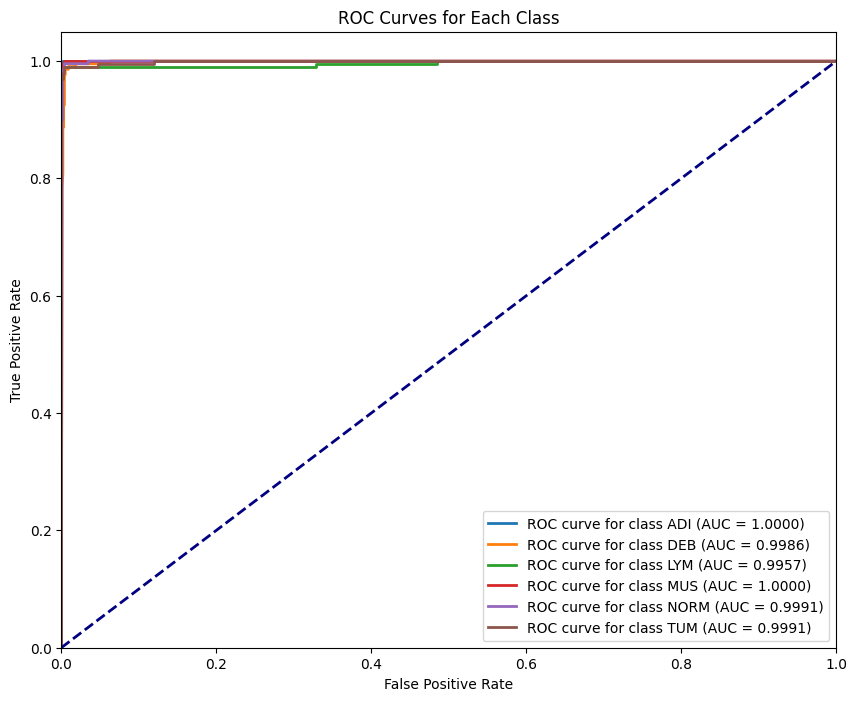

In [ ]:
#precision, recall, f1-score, AUC and ROC base on micro-average
class_names = ['ADI', 'DEB', 'LYM', 'MUS', 'NORM', 'TUM']

# Initialize lists to store all predicted probabilities and labels
all_predictions = []
all_labels = []
all_probs = []

# Collect the predicted probabilities and true labels
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Get model outputs (logits)
        outputs = model(inputs)
        # Apply softmax to get probabilities
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        # Append predictions, probabilities, and labels
        all_predictions.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert to numpy arrays
all_predictions = np.array(all_predictions)
all_probs = np.array(all_probs)
all_labels = np.array(all_labels)

#Calculate precision, recall, and f1-score using micro-average for each class
for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)
    binary_preds = np.where(all_predictions == class_idx, 1, 0)

    # Calculate micro-average precision, recall, and f1-score for each class
    precision, recall, f1_score, _ = precision_recall_fscore_support(binary_labels, binary_preds, average='micro')

    # Print the results for each class
    print(f"Micro-average Precision for class {class_name}: {precision:.4f}")
    print(f"Micro-average Recall for class {class_name}: {recall:.4f}")
    print(f"Micro-average F1-Score for class {class_name}: {f1_score:.4f}")

#Calculate ROC and AUC for each class, and plot all ROC curves
plt.figure(figsize=(10, 8))

for class_idx, class_name in enumerate(class_names):
    binary_labels = np.where(all_labels == class_idx, 1, 0)

    # Calculate ROC curve and AUC for the current class
    fpr, tpr, _ = roc_curve(binary_labels, all_probs[:, class_idx])
    roc_auc = auc(fpr, tpr)

    # Plot ROC curve for the current class
    plt.plot(fpr, tpr, lw=2, label=f'ROC curve for class {class_name} (AUC = {roc_auc:.4f})')

# Plot the diagonal line (chance level)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Configure plot
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Each Class')
plt.legend(loc="lower right")
plt.show()